In [24]:
import nltk
import gensim
from nltk.stem.snowball import SnowballStemmer
import re
import string
from gensim.test.utils import common_texts
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
import pickle
import pandas as pd
import numpy
import gc
import os
import numpy as np
from sklearn.cluster import KMeans
from sklearn.cluster import SpectralClustering
from sklearn.decomposition import PCA
from gensim.test.utils import get_tmpfile
nltk.download('stopwords')
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/alexander/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [64]:
data = np.load('/media/alexander/UUI/DatasetPatents1C.npy', allow_pickle=True)
start = True

In [63]:
data = pd.DataFrame(data)
data[7] = data[7].replace('', np.nan)
data = data.dropna(axis=0, subset=[7])
data = data.reset_index(drop=True)
if start:
    justText = data[3]
else:
    justText = justText.append(data[3])

142196


In [5]:
print(len(justText))


22335


In [25]:
## stopwords
stopWords = nltk.corpus.stopwords.words('english')

alphabet = ['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 
            'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z']

specific = ['invention','improve','reference','accompanying','drawings','letters',
            'reference', 'ending' 'hereby','declare','following','end','fig', 'said',
            'invent', 'state','forming','part','dated','application','filed','invented', 
            'united','states','certain','new','useful','improvements','patent', 'no', 'thus','',
            'inventor', 'figur', 'figure', 'date', 'file', 'applic', 'john', 'william', 'improvement', 
            'james', 'joseph', 'thomas', 'charles', 'george', 'geoege', 'peter', 'chaeles', 'samuel', 
            'peter', 'henri', 'edward', 'petere', 'peters', 'henry', 'edwaed', 'geobge', 'heney', 
            'describe', 'upon', 'shown', 'side', 'provide','therebi', 'thereby', 'describe', 
            'claim', 'set', 'forth', 'testimoni', 'testimony', 'claim', 'forego', 'sign', 'name',
            'presence', 'subscribe', 'wit', 'with', 'similar', 'york', 'assignore', 'assignor', 'serial', 'citizen', 
            'resident', 'county', 'counti', 'specify', 'specific', 'combine', 'ordinary', 'ordinari',
            'concern', 'model', 'last', 'office', 'section', 'view', 'officer', 'fig', 'figi', 'figure' 'shown',
            'jersey', 'hereby', 'herebi',  'hereunto', 'day', 'whereof', 'produce', 'hand', 'seal', 'presence', 'specify', 'object', 
            'improve', 'improvement', 'thereof', 'herein', 'set', 'forth', 'claim', 'refer', 'similar', 'also', 'first', 
            'last', 'understood', 'reside', 'patent', 'full', 'clear', 'exact', 'make', 'use', 'sheetsheet', 
            'sheetssheet', 'company', 'compani', 'assignor', 'section', 'line', 'illustrate', 'illustration', 
            'view', 'represent', 'front', 'back', 'similar',  'thereon', 'improv', 'sheet', 'ing', 'within', 
             'plan',  'need', 'refer', 'upper', 'lower', 'dot', 'guide', 'outer', 'inner', 'particular', 'refer', 'distance'
            'look', 'enlarge', 'descript', 'description', 'descriptions', 'specif', 'part', 'figur', 'offic',
            'correspond', 'side', 'piece', 'forming', 'part',  'letters', 'application','reference', 'specification',  
            'known', 'improvements', 'filed', 'file', 'whom', 'concern', 'patented', 'improved', 'rear', 
            'presence', 'testimony', 'witness', 'witnesses', 'face', 'drawing', 'drawings', 'invented', 'new',
            'useful', 'improveme', 'following', 'specified', 'connect', 'form', 'forming',  'use', 'relate','forego', 'sign',
            'subscribe', 'fig.', 'approximate', 'part', 'corresponding', 'relating', 'forms', 'provide',
            'describe', 'substantiate', 'sept', 'due', 'kept', 'longer', 'consist', 'arrange', 'combine', 'part',
            'claim', 'omit', 'other', 'skill', 'art', 'enable', 'hereinaft', 'hereinafter', 'arthur', 'freeman', 'reside',
            'residing', 'thereonwhich', 'mark', 'appertain', 'iv', 'easily', 'gustav', 'state', 'stateof', 'purpose', 'oscar',
            'campbell', 'campbel', 'use', 'myimprov', 'myimprovement', 'formingpart', 'german', 'germany',
            'france', 'king', 'combine', 'connect', 'subscribe', 'describe' ]


cities = ['Reading',
 'Duluth',
 'Los Angeles',
 'Somerville',
 'Boston',
 'Yonkers',
 'Wheeling',
 'New Orleans',
 'Camden',
 'Williamsport',
 'Tacoma',
 'Hoboken',
 'St. Joseph',
 'Birmingham',
 'Birmingham',
 'Newark',
 'Harrisburg',
 'Columbus',
 'Oakland',
 'Memphis',
 'Minneapolis',
 'Louisville',
 'Richmond',
 'Chicago',
 'Auburn',
 'Indianapolis',
 'Peoria',
 'Dubuque',
 'Akron',
 'Paterson',
 'Denver',
 'Poughkeepsie',
 'New Haven',
 'New Albany',
 'Trenton',
 'Lowell',
 'Albany',
 'Newport',
 'Troy',
 'Worcester',
 'Saginaw',
 'Omaha',
 'Evansville',
 'Rochester',
 'Philadelphia',
 'St. Paul',
 'Utica',
 'Nashville',
 'Wilmington',
 'Kansas City',
 'Altoona',
 'Springfield',
 'Charlestown',
 'San Francisco',
 'Dallas',
 'New Bedford',
 'Norfolk',
 'Mobile',
 'Savannah',
 'Covington',
 'Syracuse',
 'Lynn',
 'Little Rock',
 'Binghamton',
 'Salem',
 'Providence',
 'Brockton',
 'Buffalo',
 'Washington',
 'Lawrence',
 'Toledo',
 'Charleston',
 'Lancaster',
 'Quincy',
 'Cincinnati',
 'Cambridge',
 'New Brunswick',
 'Davenport',
 'Holyoke',
 'Burlington',
 'Des Moines',
 'Milwaukee',
 'Allegheny',
 'Oswego',
 'Scranton',
 'Bangor',
 'Topeka',
 'Seattle',
 'Wilkes-Barre',
 'St. Louis',
 'Dayton',
 'Fort Wayne',
 'Pittsburgh',
 'Baltimore',
 'Elmira',
 'Leavenworth',
 'Jersey City',
 'Pawtucket',
 'Norwich',
 'San Antonio',
 'Petersburg',
 'Newburgh',
 'Atlanta',
 'Hartford',
 'Taunton',
 'Houston',
 'Philadelphia',
 'Grand Rapids',
 'Chelsea',
 'Salt Lake City',
 'Portland',
 'Augusta',
 'Lincoln',
 'Waterbury',
 'Bridgeport',
 'Brooklyn',
 'Elizabeth',
 'Chicago',
 'New York city',
 'Cohoes',
 'Terre Haute',
 'Sioux City',
 'Manchester',
 'Detroit',
 'Fall River',
 'Sacramento',
 'Youngstown',
 'Cleveland',
 'Erie']

states = ["AL", "AK", "AZ", "AR", "CA", "CO", "CT", "DC", "DE", "FL", "GA", 
          "HI", "ID", "IL", "IN", "IA", "KS", "KY", "LA", "ME", "MD", 
          "MA", "MI", "MN", "MS", "MO", "MT", "NE", "NV", "NH", "NJ", 
          "NM", "NY", "NC", "ND", "OH", "OK", "OR", "PA", "RI", "SC", 
          "SD", "TN", "TX", "UT", "VT", "VA", "WA", "WV", "WI", "WY","Alabama","Alaska","Arizona","Arkansas","California","Colorado",
          "Connecticut","Delaware","Florida","Georgia","Hawaii","Idaho","Illinois",
          "Indiana","Iowa","Kansas","Kentucky","Louisiana","Maine","Maryland",
          "Massachusetts","Michigan","Minnesota","Mississippi","Missouri","Montana",
          "Nebraska","Nevada","New Hampshire","New Jersey","New Mexico","New York",
          "North Carolina","North Dakota","Ohio","Oklahoma","Oregon","Pennsylvania",
          "Rhode Island","South Carolina","South Dakota","Tennessee","Texas","Utah",
          "Vermont","Virginia","Washington","West Virginia","Wisconsin","Wyoming"]

months = ['january', 'february', 'march', 'april', 'may', 'june', 'july', 'august', 'september', 'october', 'november', 'december',
         'jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec']

nums = ['one', 'two', 'three', 'four', 'five', 'six', 'seven', 'eight', 'nine', 'ten', 'eleven', 'twelve', 'fifty', 'hundred', 'thousand']


for a in range(len(alphabet)):
    stopWords.append(alphabet[a])
    
for st in range(len(states)):
    stopWords.append(states[st].lower())
    
for s in range(len(specific)):
    stopWords.append(specific[s])
    
for c in range(len(cities)):
    stopWords.append(cities[c].lower())
    
for n in range(len(nums)):
    stopWords.append(nums[n])
    
for m in range(len(months)):
    stopWords.append(months[m])
    
for n in range(100):
    stopWords.append(str(n))
    
for n in range(1860, 1910):
    stopWords.append(str(n))

## stemmer
stemmer = SnowballStemmer("english")

def tokenize(text):
    
    ## remove extra spaces and tokenize
    words = re.sub('\s+', ' ', text).split(" ")
    
    ## remove stopwords
    temp = [] 
    for r in words: 
        r = r.lower()
        r = r.translate(str.maketrans('', '', string.punctuation))
        r = r.translate(str.maketrans('', '', string.digits))
        if not r in stopWords: 
            temp.append(r) 
    words = temp
    
    ## stem words
    #singles = [stemmer.stem(w) for w in words]

    return words

def tokenSet(text):
    rem = string.punctuation
    pattern = r"[{}]".format(rem)
    chars = ['\n', '\xa0', '\t']
    text = text.str.replace(pattern, '')
    for i in range(len(chars)):
        text = text.replace({chars[i]:''}, regex=True)
    
    tokens = [''] * len(text)
    for i in range(len(text)):
        if (i%5000==0):
            print(str(i) +'/' + str(len(text)))
        tokens[i] = tokenize(str(text[i]))
    return tokens

In [7]:
tokens = tokenSet(justText)

0/22335
5000/22335
10000/22335
15000/22335
20000/22335


In [8]:
np.save('/media/alexander/UUI/tokens6.npy', tokens, True)

tokens = np.load('/media/alexander/UUI/tokens1.npy', allow_pickle=True)


In [1]:
import gc
tokens = np.load('/media/alexander/UUI/tokens4.npy', allow_pickle=True)

In [2]:
tokens = np.append(tokens, np.load('/media/alexander/UUI/tokens5.npy', allow_pickle=True))


In [3]:
tokens = np.append(tokens, np.load('/media/alexander/UUI/tokens6.npy', allow_pickle=True))

In [4]:
len(tokens)

116727

In [5]:
wordcount = {}
for i in range(len(tokens)):
    for word in tokens[i]:
        if word not in wordcount:
            wordcount[word] = 1
        else:
            wordcount[word] += 1
crucialWords = pd.DataFrame.from_dict({k: v for k, v in sorted(wordcount.items(), key=lambda item: item[1])}, orient='index')[-300000:].index


In [5]:
frameWordCount = pd.DataFrame.from_dict(c, orient='index')
wordcount = []

frameWordCount

NameError: name 'c' is not defined

In [7]:
#409720 398000
frameWordCount[-409720:]

,0
ceerce,1
tiiercn,1
thehingesupport,1
khorizont,1
oppositeiyproject,1
...,...
secur,466566
posit,471600
describ,515913
provid,530888


In [8]:
crucialWords = frameWordCount[-398000:].index
crucialWords


Index(['clickrun', 'uponthegrippershaft', 'seenfbi', 'totheleft', 'offthespr',
       'seizediinth', 'hegrip', 'pulleyslk', 'tfape', 'thenextcylind',
       ...
       'shaft', 'mean', 'substanti', 'combin', 'oper', 'secur', 'posit',
       'describ', 'provid', 'connect'],
      dtype='object', length=398000)

In [7]:
def rmvNonCruc(tokens):
    for i in range(len(tokens)):
        temp = [] 
        for r in tokens[i]: 
            if r in crucialWords: 
                temp.append(r)
        tokens[i]= None
        tokens[i] = temp
    return tokens

In [8]:
crucTokens = rmvNonCruc(tokens)
len(crucTokens)

116727

In [9]:

tokens = None
gc.collect()


179

In [13]:
np.save('/media/alexander/UUI/crucialT2.npy', tokens, True)

MemoryError: 

In [2]:
crucTokens = np.load('/media/alexander/UUI/crucialT1.npy', allow_pickle=True)

In [3]:
len(crucTokens)

142196

In [4]:
retext = [''] * len(crucTokens)
for i in range(len(crucTokens)):
    text = " "
    for w in range(len(crucTokens[i])):
        text = text + " " + crucTokens[i][w]
    retext[i] = text
retext[2]

'  dilat gatuit ioiin boda extensiont schedul refer ton make lwhom boda montgomeri extensiont anddo aful make tabl sidev elev like kind figur relat class extensiont iu lazytong devic isv employ togeth section consist iu employ support furth adjust leav general construct arrang various part devic annex repres section tabl provid semicircular top support leg close togeth project horizont outward straight edg top open top opposit hold firm place circular tabl connect end section lazytong devic short bar pivot togeth centr end permit ofth extens close togeth desir supportingleg direct beneath centr lazytong suitabl loos board leav ibr insert section complet extensiont howev oneseri defect loos movabl board firm support tabl extend length abovenam defect aris arrang bar onehalf place other vthat extend line drawn across right angl extens would mani place touch bar edg leav rest line would unsupport remedi difliculti piu secur project upward bar midway end centr come lush surfac bar furnish 

In [5]:
crucTokens = None
gc.collect()

NameError: name 'gc' is not defined

In [6]:
np.save('/media/alexander/UUI/retext1.npy', pd.DataFrame(retext), True)

In [8]:
print(len(retext))
retext = np.load('/media/alexander/UUI/retext1.npy', allow_pickle=True)
print(len(retext))



116727
142196


In [2]:

retext = np.append(np.load('/media/alexander/UUI/retext1.npy', allow_pickle=True),np.load('/media/alexander/UUI/retext2.npy', allow_pickle=True))
print(len(retext))

258923


In [3]:
documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(retext)]

In [4]:

modelD2V = Doc2Vec(documents, vector_size=5, window=2, min_count=1, workers=4)

In [5]:
modelD2V.train(documents, total_examples=modelD2V.corpus_count, epochs=15, start_alpha=0.002, end_alpha=-0.016)

In [77]:
%matplotlib inline

pca = PCA(n_components=2).fit(modelD2V.docvecs.doctag_syn0)
datapoint = pca.transform(modelD2V.docvecs.doctag_syn0)
plt.figure(figsize=[80,80])
plt.scatter(datapoint[:, 0], datapoint[:, 1])
plt.show()

/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:3: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:4: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  after removing the cwd from sys.path.


AttributeError: module 'matplotlib.pyplot' has no attribute 'set_facecolor'

<Figure size 5760x5760 with 0 Axes>

In [78]:
pca = PCA(n_components=3).fit(modelD2V.docvecs.doctag_syn0)
datapoint = pca.transform(modelD2V.docvecs.doctag_syn0)

/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  """Entry point for launching an IPython kernel.
/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  


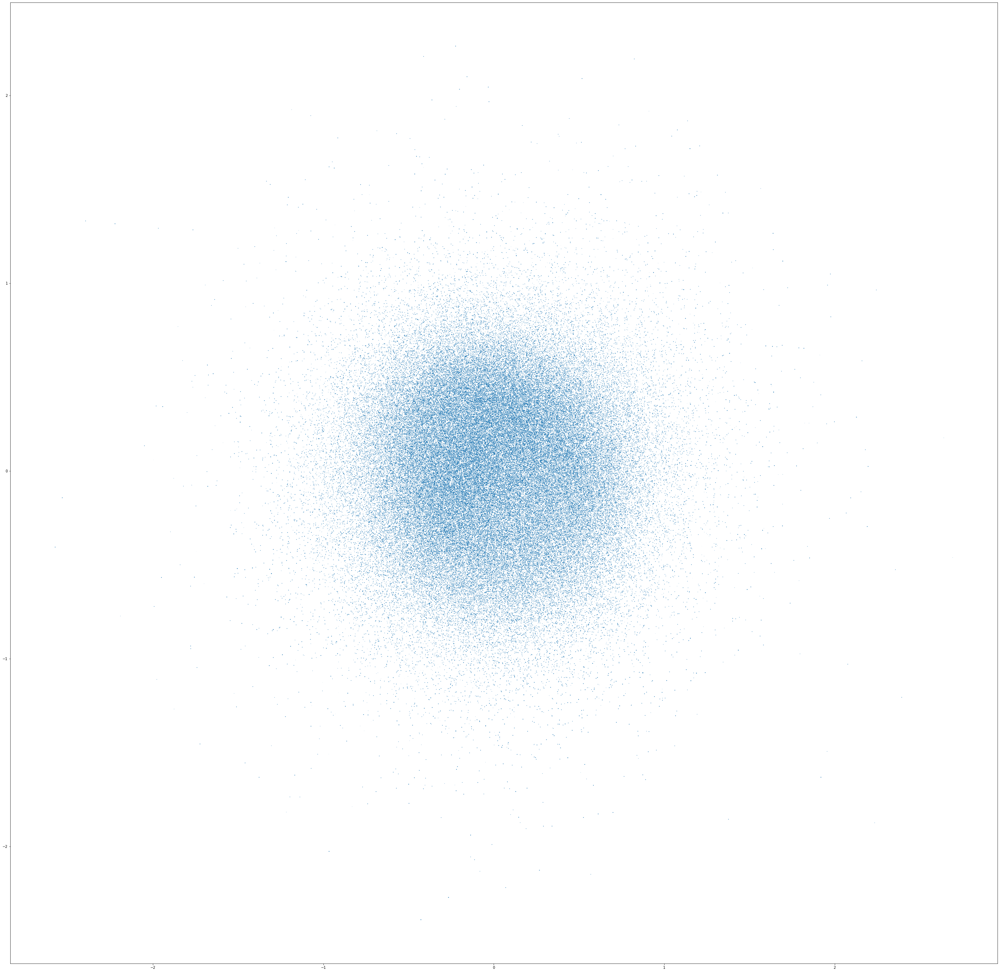

In [68]:



plt.figure(figsize=[50,50])
plt.scatter(datapoint[:, 0], datapoint[:, 1], datapoint[:, 2])
plt.show()

In [71]:
datapoint[:, 0]

array([-0.38316736,  0.77366924,  0.09041513, ..., -0.48747858,
       -0.47445267, -0.3879867 ], dtype=float32)

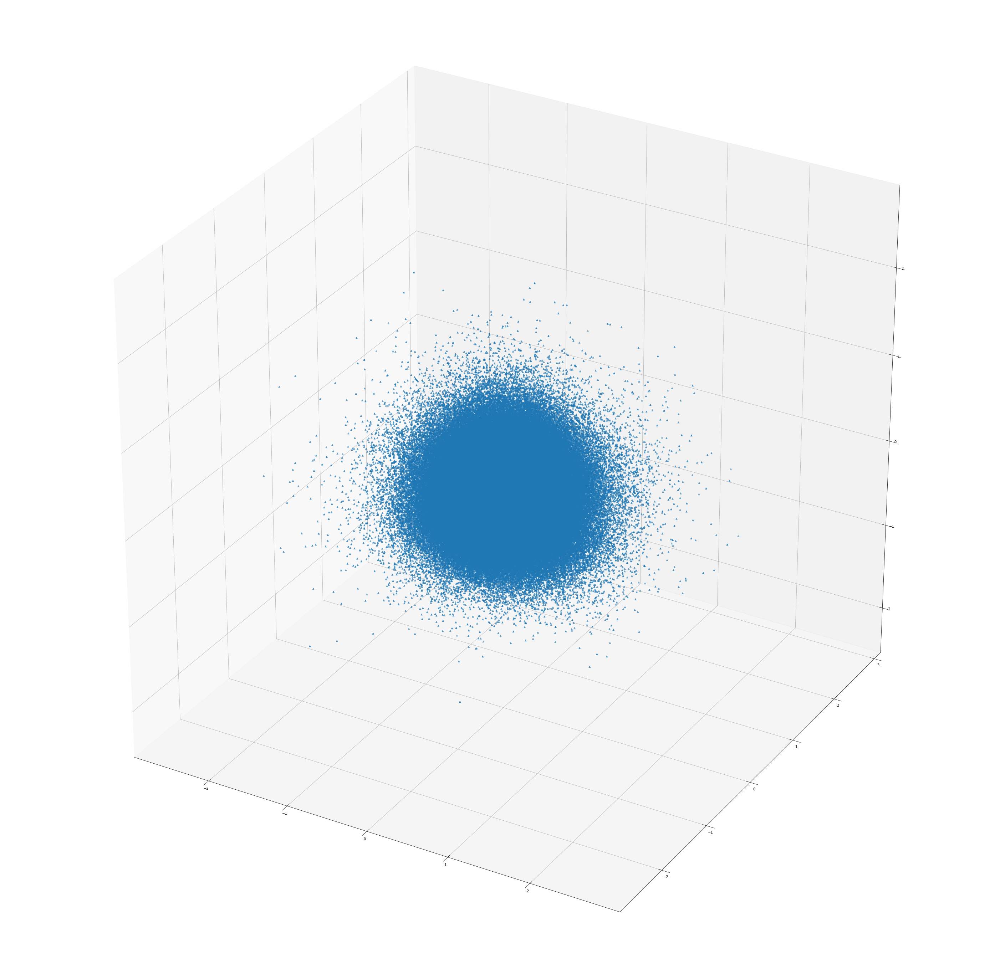

In [80]:

fig = plt.figure(figsize=[50,50])
ax = fig.add_subplot(111, projection='3d')

ax.scatter(datapoint[:, 0], datapoint[:, 1], datapoint[:, 2], marker='^')

plt.show()


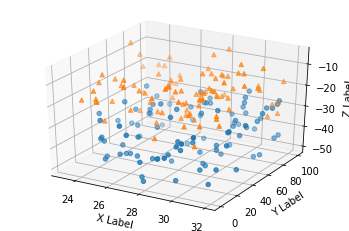

In [72]:
np.random.seed(19680801)


def randrange(n, vmin, vmax):
    '''
    Helper function to make an array of random numbers having shape (n, )
    with each number distributed Uniform(vmin, vmax).
    '''
    return (vmax - vmin)*np.random.rand(n) + vmin

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

n = 100

# For each set of style and range settings, plot n random points in the box
# defined by x in [23, 32], y in [0, 100], z in [zlow, zhigh].
for m, zlow, zhigh in [('o', -50, -25), ('^', -30, -5)]:
    xs = randrange(n, 23, 32)
    ys = randrange(n, 0, 100)
    zs = randrange(n, zlow, zhigh)
    ax.scatter(xs, ys, zs, marker=m)

ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

plt.show()


In [16]:
clustering = SpectralClustering(n_clusters=4, assign_labels="discretize",random_state=0).fit(modelD2V.docvecs.doctag_syn0)

/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  """Entry point for launching an IPython kernel.


MemoryError: Unable to allocate array with shape (142196, 142196) and data type float64

In [95]:
kmeans_model = KMeans(n_clusters=8, init='k-means++', max_iter=10000) 
X = kmeans_model.fit(modelD2V.docvecs.doctag_syn0)
labels=kmeans_model.labels_.tolist()
l = kmeans_model.fit_predict(modelD2V.docvecs.doctag_syn0)


/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  
/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:4: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  after removing the cwd from sys.path.


/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  """Entry point for launching an IPython kernel.
/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  


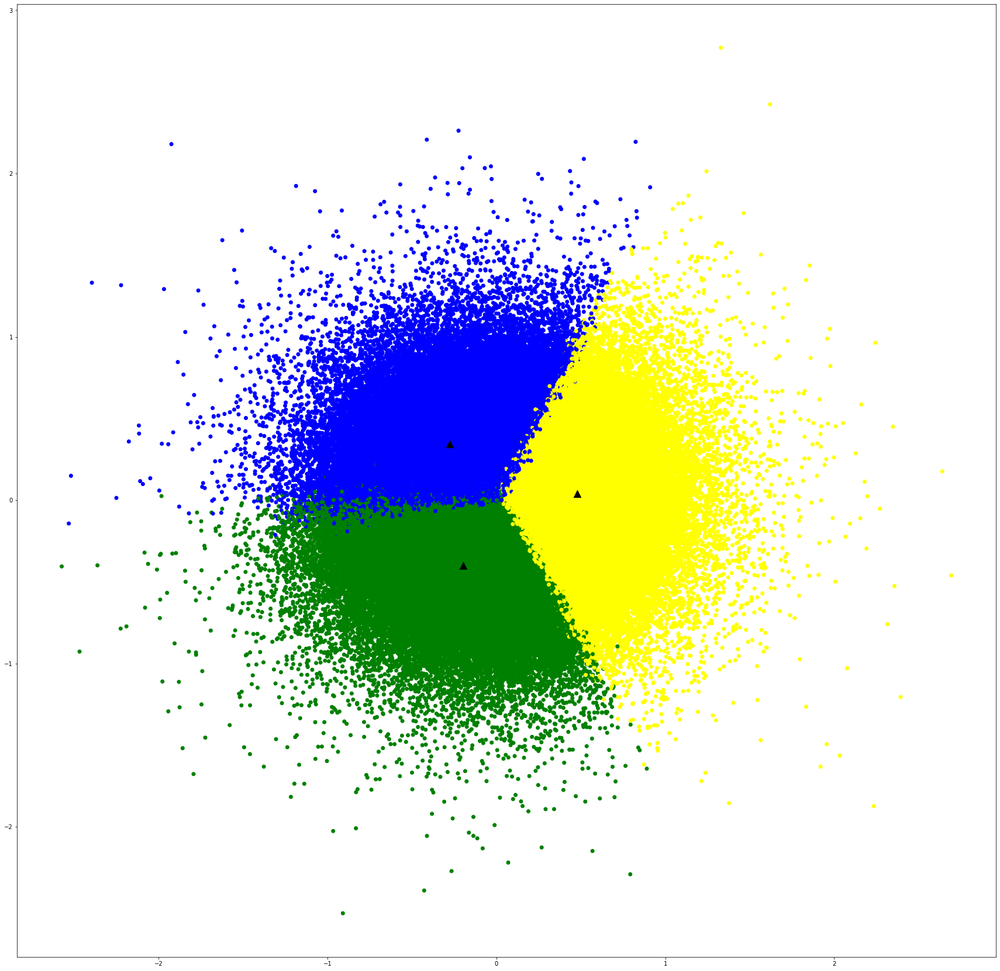

In [93]:
pca = PCA(n_components=2).fit(modelD2V.docvecs.doctag_syn0)
datapoint = pca.transform(modelD2V.docvecs.doctag_syn0)
%matplotlib inline

plt.figure(figsize=[30,30])
label1 = ["#FFFF00", "#008000", "#0000FF", "#807689", "#ff99ff", "#ff0000", "#090914", "#ff9900", "#ccafaf", "#cd02fa", "#02f2fa", "#2bfa02" ]
color = [label1[i] for i in labels]
plt.scatter(datapoint[:, 0], datapoint[:, 1], c=color)
          
centroids = kmeans_model.cluster_centers_
centroidpoint = pca.transform(centroids)
plt.scatter(centroidpoint[:, 0], centroidpoint[:, 1], marker='^', s=150, c='#000000')
plt.show()

/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  """Entry point for launching an IPython kernel.
/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  


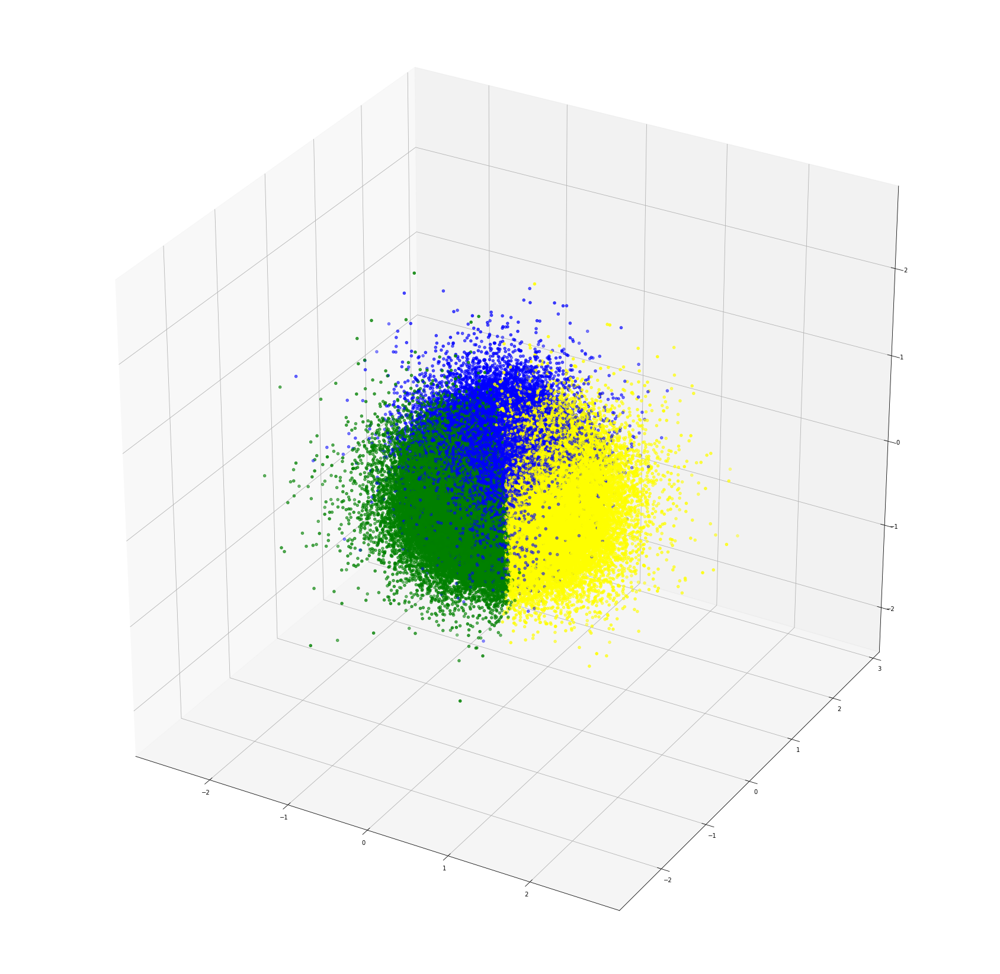

In [94]:
pca = PCA(n_components=3).fit(modelD2V.docvecs.doctag_syn0)
datapoint = pca.transform(modelD2V.docvecs.doctag_syn0)
fig = plt.figure(figsize=[30,30])
label1 = ["#FFFF00", "#008000", "#0000FF", "#807689", "#ff99ff", "#ff0000", "#090914", "#ff9900", "#ccafaf", "#cd02fa", "#02f2fa", "#2bfa02" ]
color = [label1[i] for i in labels]
ax = fig.add_subplot(111, projection='3d')

ax.scatter(datapoint[:, 0], datapoint[:, 1], datapoint[:, 2], c=color)
centroids = kmeans_model.cluster_centers_
centroidpoint = pca.transform(centroids)
ax.scatter(centroidpoint[:, 0], centroidpoint[:, 1], centroidpoint[:, 2], marker='^', s=150, c='#000000')

plt.show()

In [96]:
np.save('/media/alexander/UUI/labels8F.npy', labels, True)

In [27]:
from sklearn.cluster import MeanShift, estimate_bandwidth
bandwidth = estimate_bandwidth(modelD2V.docvecs.doctag_syn0, quantile=0.2, n_samples=500)

ms = MeanShift(bandwidth=bandwidth, bin_seeding=True)
ms.fit(modelD2V.docvecs.doctag_syn0)
labels = ms.labels_
cluster_centers = ms.cluster_centers_

labels_unique = np.unique(labels)
n_clusters_ = len(labels_unique)

print("number of estimated clusters : %d" % n_clusters_)

/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  
/home/alexander/.local/lib/python3.6/site-packages/ipykernel_launcher.py:5: DeprecationWarning: Call to deprecated `doctag_syn0` (Attribute will be removed in 4.0.0, use docvecs.vectors_docs instead).
  """


number of estimated clusters : 10


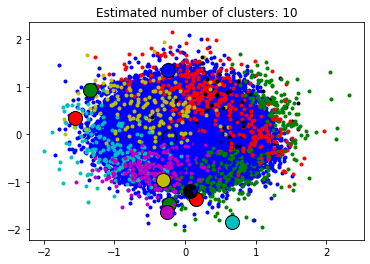

In [30]:
import matplotlib.pyplot as plt
from itertools import cycle

plt.figure(1)
plt.clf()

colors = cycle('bgrcmykbgrcmykbgrcmykbgrcmyk')
for k, col in zip(range(n_clusters_), colors):
    my_members = labels == k
    cluster_center = cluster_centers[k]
    plt.plot(datapoint[my_members, 0], datapoint[my_members, 1],  col + '.')
    plt.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col,
             markeredgecolor='k', markersize=14)
plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

In [37]:
np.save('/media/alexander/UUI/labelsMS1.npy', labels, True)

In [1]:
data = pd.DataFrame(np.load('/media/alexander/UUI/DatasetPatents1C.npy', allow_pickle=True)).drop(columns=[3,6,4,2])


In [2]:
data = data.append(pd.DataFrame(np.load('/media/alexander/UUI/DatasetPatents2C.npy', allow_pickle=True)).drop(columns=[3,6,4,2]))

In [3]:
data = data.append(pd.DataFrame(np.load('/media/alexander/UUI/DatasetPatents3C.npy', allow_pickle=True)).drop(columns=[3,6,4,2]))
data = data.append(pd.DataFrame(np.load('/media/alexander/UUI/DatasetPatents4C.npy', allow_pickle=True)).drop(columns=[3,6,4,2]))
data = data.append(pd.DataFrame(np.load('/media/alexander/UUI/DatasetPatents5C.npy', allow_pickle=True)).drop(columns=[3,6,4,2]))
data = data.append(pd.DataFrame(np.load('/media/alexander/UUI/DatasetPatents6C.npy', allow_pickle=True)).drop(columns=[3,6,4,2]))

In [4]:
data


,0,1,5,7
0,US98459A,Improvement in clamps for elevating well tubes...,1869-12-28,
1,US98460A,Improvement in asphalt pavements,1870-01-04,
2,US98461A,Improvement in machine for making nets,1870-01-04,
3,US98462A,Improved gas-machine,1870-01-04,
4,US98463A,Improved child s chair and table,1870-01-04,Newark city
...,...,...,...,...
51524,US649995A,Hat-forming machine. \n,1900-05-22,
51525,US649996A,Machine for forming sheet-metal tubes. \n,1900-05-22,Philadelphia city
51526,US649997A,Paper-folding machine. \n,1900-05-22,Manchester city
51527,US649998A,Element for storage batteries. \n,1900-05-22,Cleveland city


In [5]:
data[7] = data[7].replace('', np.nan)
data = data.dropna(axis=0, subset=[7])
data = data.reset_index(drop=True)
print(len(data))

258923


In [6]:
labels = np.load('/media/alexander/UUI/labels8F.npy', allow_pickle=True)

In [7]:
len(labels)

258923

In [8]:
data['Cluster Label'] = labels

In [9]:
data[152205:]

,0,1,5,7,Cluster Label
152205,US418666A,Max ams,1890-01-07,New York city,5
152206,US418670A,Island,1890-01-07,Washington city,6
152207,US418671A,Car-coupling,1890-01-07,Des Moines city,4
152208,US418672A,Box-fastener,1890-01-07,Brooklyn city,7
152209,US418678A,blades,1890-01-07,Washington city,1
...,...,...,...,...,...
258918,US649990A,Underground electric-railway system. \n,1900-05-22,Allegheny city,4
258919,US649992A,Grain-elevator for threshing-machines. \n,1900-05-22,Peoria city,0
258920,US649996A,Machine for forming sheet-metal tubes. \n,1900-05-22,Philadelphia city,3
258921,US649997A,Paper-folding machine. \n,1900-05-22,Manchester city,2


In [10]:
data = data.reset_index(drop=True)
seventy = data[:56306]

In [11]:
eighty = data[56307:152205]

In [12]:
ninety = data[152205:]

In [13]:
dataByCluster = data.groupby('Cluster Label')
sevByCluster = seventy.groupby('Cluster Label')
eigByCluster = eighty.groupby('Cluster Label')
ninByCluster = ninety.groupby('Cluster Label')
type(dataByCluster)

pandas.core.groupby.generic.DataFrameGroupBy

In [11]:
list1 = list(dataByCluster)[1]
list1C = list1[1][7]
list1C

57               Boston city
1043          Allegheny city
1581         Cincinnati city
1732          Allegheny city
1992      San Francisco city
                 ...        
258369        Milwaukee city
258558         Syracuse city
258658             Erie city
258734         Portland city
258875            Akron city
Name: 7, Length: 29412, dtype: object

In [12]:
countedCities = list1C.value_counts()
namesX = countedCities.index
namesX
names = [''] * len(namesX)
for i in range(len(namesX)):
    if(namesX[i][:9]==' New York' or namesX[i][:8]=='New York'):
        city = namesX[i]
    elif(namesX[i][-5:] == ' city'):
        city = namesX[i][:-5]
    names[i] = city
names

['Washington',
 'Chicago',
 'Brooklyn',
 'Philadelphia',
 'Boston',
 'Allegheny',
 'St. Louis',
 'New Haven',
 'Cleveland',
 'Hartford',
 'San Francisco',
 'Newark',
 'Erie',
 'Baltimore',
 ' New York city',
 'Providence',
 ' Philadelphia',
 'Worcester',
 'Springfield',
 'Cincinnati',
 'Detroit',
 'Milwaukee',
 'Indianapolis',
 'Rochester',
 'Bridgeport',
 'Minneapolis',
 'Lynn',
 'Lancaster',
 'Syracuse',
 'Albany',
 'Richmond',
 'Norfolk',
 'Jersey City',
 'Dayton',
 'Lawrence',
 'Portland',
 'Kansas City',
 'Lowell',
 'Denver',
 'Manchester',
 'St. Joseph',
 'New Orleans',
 'Grand Rapids',
 'Louisville',
 'Columbus',
 'Troy',
 'Cambridge',
 'Toledo',
 'Los Angeles',
 'Paterson',
 'Camden',
 'Oakland',
 'Peoria',
 'St. Paul',
 'Auburn',
 'Yonkers',
 'Birmingham',
 'Akron',
 'Lincoln',
 'Salem',
 'Burlington',
 'Somerville',
 'Reading',
 'Norwich',
 'Quincy',
 'Elizabeth',
 'Atlanta',
 'Taunton',
 'Waterbury',
 'New York city',
 'Newport',
 'Hoboken',
 'Des Moines',
 'Pawtucket',
 'Ch

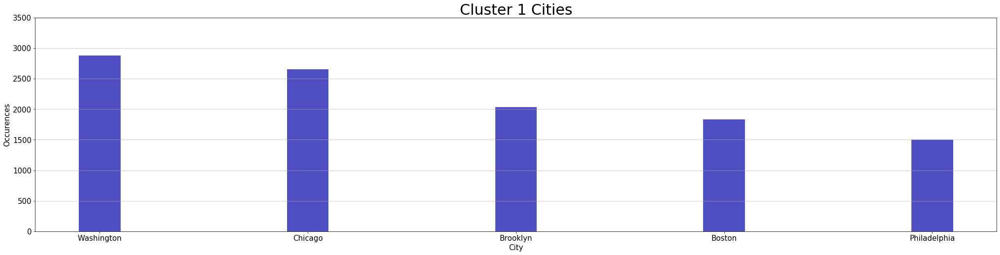

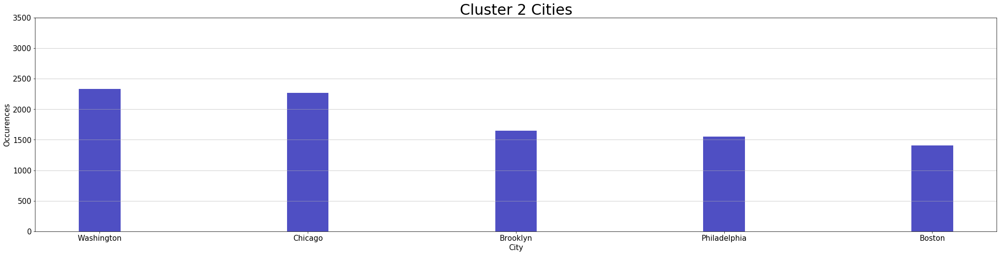

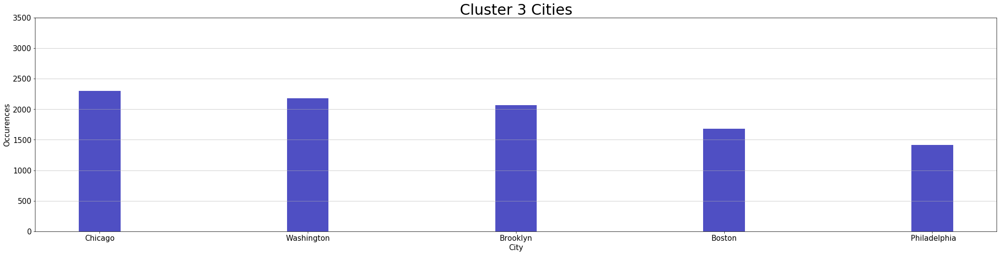

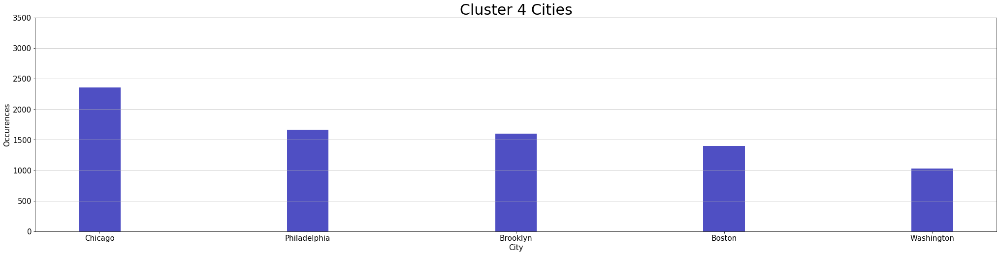

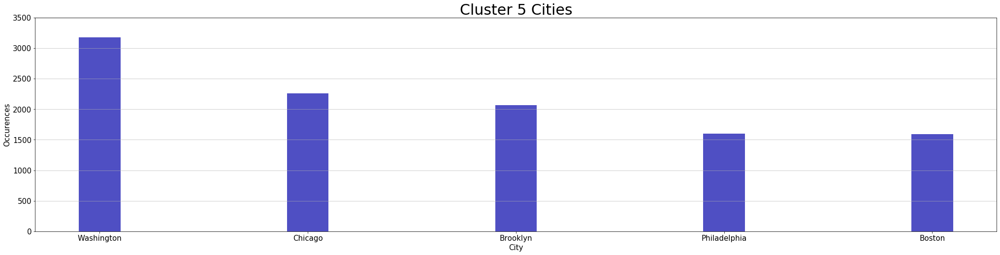

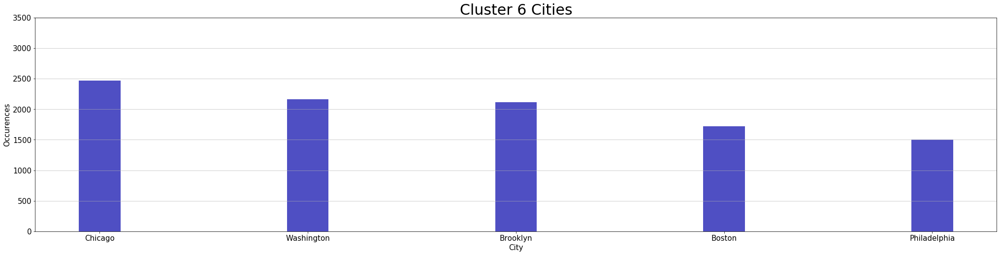

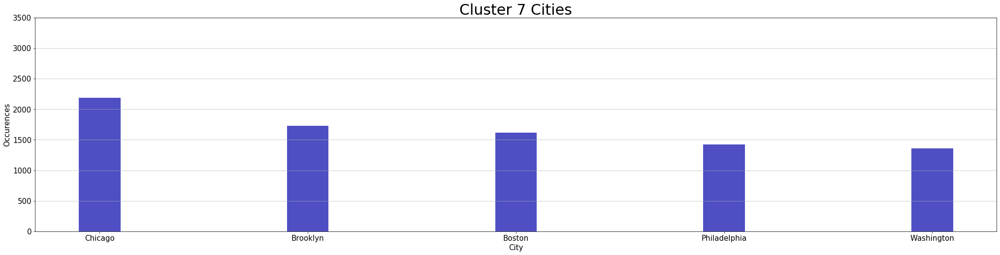

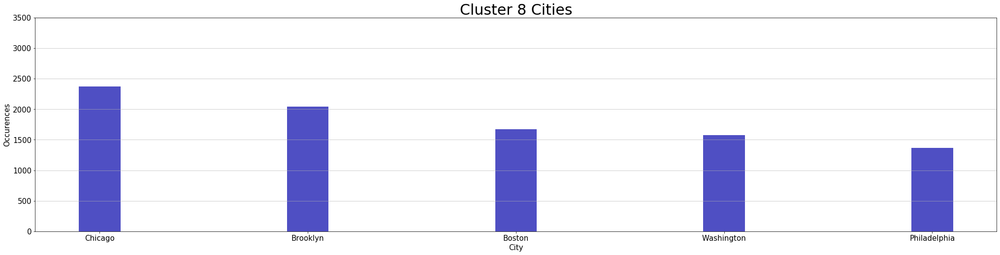

In [28]:
for j in range(8):
    list1 = list(dataByCluster)[j]
    list1C = list1[1][7]
    
    countedCities = list1C.value_counts()
    namesX = countedCities.index
    
    names = [''] * len(namesX)
    for i in range(len(namesX)):
        if(namesX[i][:9]==' New York' or namesX[i][:8]=='New York'):
            city = namesX[i]
        elif(namesX[i][-5:] == ' city'):
            city = namesX[i][:-5]
        names[i] = city
        
    graphName = 'Cluster ' + str(j+1) + ' Cities'
    
    plt.figure(figsize=[35,8])
    
    plt.bar(names[:5], countedCities[:5], width = 0.2, color='#0504aa',alpha=0.7)
    plt.grid(axis='y', alpha=0.75)
    plt.ylim((0, 3500))
    plt.xlabel('City',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.ylabel('Occurences',fontsize=15)
    plt.title(graphName,fontsize=30)
    plt.show()

In [59]:
list1 = list(dataByCluster)[2]
list1N = list1[1][1]
list1N = list1N.reset_index(drop=True)
list1N

0                                           Samuel w 
1            Improvement in machines for making rope 
2                        Improvement in rein-holders 
3                           Improved curtain-fixture 
4                                           William  
                             ...                     
27805          Acetylene-gas-generating lamp. \n     
27806    Means for suspending bedclothes, &c. \n     
27807           Printing and folding machine. \n     
27808                                   Pail. \n     
27809    Underground electric-railway system. \n     
Name: 1, Length: 27810, dtype: object

In [62]:
list1N = tokenSet(list1N)
wordcount = {}
for i in range(len(list1N)):
    for word in list1N[i]:
        if word not in wordcount:
            wordcount[word] = 1
        else:
            wordcount[word] += 1
c = {k: v for k, v in sorted(wordcount.items(), key=lambda item: item[1])}
c

0/27810
5000/27810
10000/27810
15000/27810
20000/27810
25000/27810


{'bottojiley': 1,
 'greenwood': 1,
 'filteringapparatus': 1,
 'watergaug': 1,
 'tonnag': 1,
 'circularloom': 1,
 'scrollcas': 1,
 'communicatingapparatus': 1,
 'boltheadiwg': 1,
 'safford': 1,
 'gutekunst': 1,
 'be': 1,
 'mortisingmachinb': 1,
 'hedgetrimm': 1,
 'peatattq': 1,
 'windowbutton': 1,
 'roofingmateri': 1,
 'shrink': 1,
 'balingfress': 1,
 'trowbridg': 1,
 'tongt': 1,
 'usathersamm': 1,
 'harvestergear': 1,
 'ip': 1,
 'kloxz': 1,
 'maetino': 1,
 'laundrybench': 1,
 'currentwheel': 1,
 'viseclamp': 1,
 'pattkbsojr': 1,
 'engineri': 1,
 'windowfram': 1,
 'sofaloung': 1,
 'coolman': 1,
 'describ': 1,
 'blow': 1,
 'kindlingwood': 1,
 'berryman': 1,
 'cellarhoist': 1,
 'dine': 1,
 'talcott': 1,
 'grippulley': 1,
 'coalhoist': 1,
 'drivenwel': 1,
 'bhidgeq': 1,
 'sasethold': 1,
 'fruitfeel': 1,
 'peanutclean': 1,
 'irank': 1,
 'hoistingkmachin': 1,
 'centeringattach': 1,
 'writingsl': 1,
 'ifet': 1,
 'scyth': 1,
 'paperengin': 1,
 'charcoal': 1,
 'osoab': 1,
 'fugmil': 1,
 'eredg'

In [203]:
len(c)

5171

In [63]:
clusterWordCount = pd.DataFrame.from_dict(c, orient='index')
clusterWordCount[-20:]

,0
carcoupl,142
fasten,142
sewingmachin,172
box,173
lamp,194
metal,196
method,196
process,217
half,229
automat,231


In [56]:
clustWords=['']*9
clustWordsT =[]
for j in range(8):
    list1 = list(dataByCluster)[j]
    list1N = list1[1][1]
    list1N = list1N.reset_index(drop=True)
    list1N = tokenSet(list1N)
    wordcount = {}
    for i in range(len(list1N)):
        for word in list1N[i]:
            if word not in wordcount:
                wordcount[word] = 1
            else:
                wordcount[word] += 1
    c = {k: v for k, v in sorted(wordcount.items(), key=lambda item: item[1])}
    clusterWordCount = pd.DataFrame.from_dict(c, orient='index')
    clustWords[j] = clusterWordCount[-100:].index
    clustWordsT = np.append(clustWordsT, clusterWordCount[-100:].index)
    print(clusterWordCount[-30:])

0/36116
5000/36116
10000/36116
15000/36116
20000/36116
25000/36116
30000/36116
35000/36116
                   0
furnace          110
shoes            115
lamp             119
valve            124
steam            125
rotary           126
electrical       128
metal            129
metallic         131
folding          138
railway          139
holder           139
system           150
carcoupling      174
sewingmachines   192
manufacture      208
process          219
method           233
mechanism        268
half             285
automatic        288
attachment       319
making           327
island           347
combined         357
device           595
electric         607
machines         634
apparatus       1048
machine         1291
0/29412
5000/29412
10000/29412
15000/29412
20000/29412
25000/29412
                   0
switch            90
adjustable        92
elevator          93
folding           94
sewingmachines    95
rotary            98
engine           102
furnace          102
ho

In [66]:
clustWords[:][j][i] 

'sheetmetal'

In [70]:
clustWordRMV = [''] * 9
for j in range(8):
    temp = []
    for x in range(8):
        if(x != j):
            temp = np.append(temp, clustWords[:][x])
    
    for i in range(len(clustWords[:][j])):
        for y in range(len(temp)):
            if(clustWords[:][j][i] not in temp):
                 clustWordRMV[j] = np.append(clustWordRMV[j], clustWords[:][j][i])
clustWordRMV[:][1]

array(['', 'burner', 'burner', ..., 'lock', 'lock', 'lock'], dtype='<U10')

In [74]:
len(clustWordRMV[:][1])

3501

In [86]:
for j in range(8):
    print("cluster " + str(j))
    wordcount1 = {}
    for word in clustWordRMV[:][j]:
        if word not in wordcount1:
                wordcount1[word] = 1
        else:
                wordcount1[word] += 1
        c = {k: v for k, v in sorted(wordcount1.items(), key=lambda item: item[1])}
        clusterRMVCOunt = pd.DataFrame.from_dict(c, orient='index')
    print(clusterRMVCOunt[-20:])

cluster0
            0
            1
feeding   700
cleaning  700
cluster1
              0
              1
burner      700
cutter      700
velocipede  700
generator   700
lock        700
cluster2
              0
              1
revolving   700
preparing   700
firearms    700
mechanisms  700
cluster3
               0
               1
harry        700
bedbottoms   700
watercloset  700
nutlock      700
steel        700
carfender    700
cluster4
                  0
                  1
locks           700
washingmachine  700
frame           700
lewis           700
johnson         700
caraxle         700
packing         700
battery         700
vehicle         700
die             700
territory       700
telephone       700
benjamin        700
regulator       700
cluster5
                   0
                   1
sylvania         700
weighingmachine  700
cluster6
              0
              1
preserving  700
hotair      700
dies        700
leather     700
baleties    700
cluster7
           0

In [84]:
clusterRMVCOunt[-20:]

,0
,1
andrew,700
pumps,700
heaters,700
air,700


In [15]:
from math import pi

In [65]:
len(np.load('/media/alexander/UUI/DatasetPatents6C.npy', allow_pickle=True))

51529

In [22]:
countedCities[:6]

Washington city      2331
Chicago city         2271
Brooklyn city        1650
Philadelphia city    1554
Boston city          1404
Allegheny city       1087
Name: 7, dtype: int64

[2883 2653 2031 1837 1501 1194 2883]
[2331 2271 1650 1554 1404 1087 2331]
[2298 2181 2065 1681 1415 1158 2298]
[2353 1665 1599 1398 1026  987 2353]
[3175 2256 2068 1599 1594 1122 3175]
[2470 2167 2115 1722 1505 1235 2470]
[2184 1729 1615 1422 1358 1072 2184]
[2374 2041 1675 1577 1370 1193 2374]


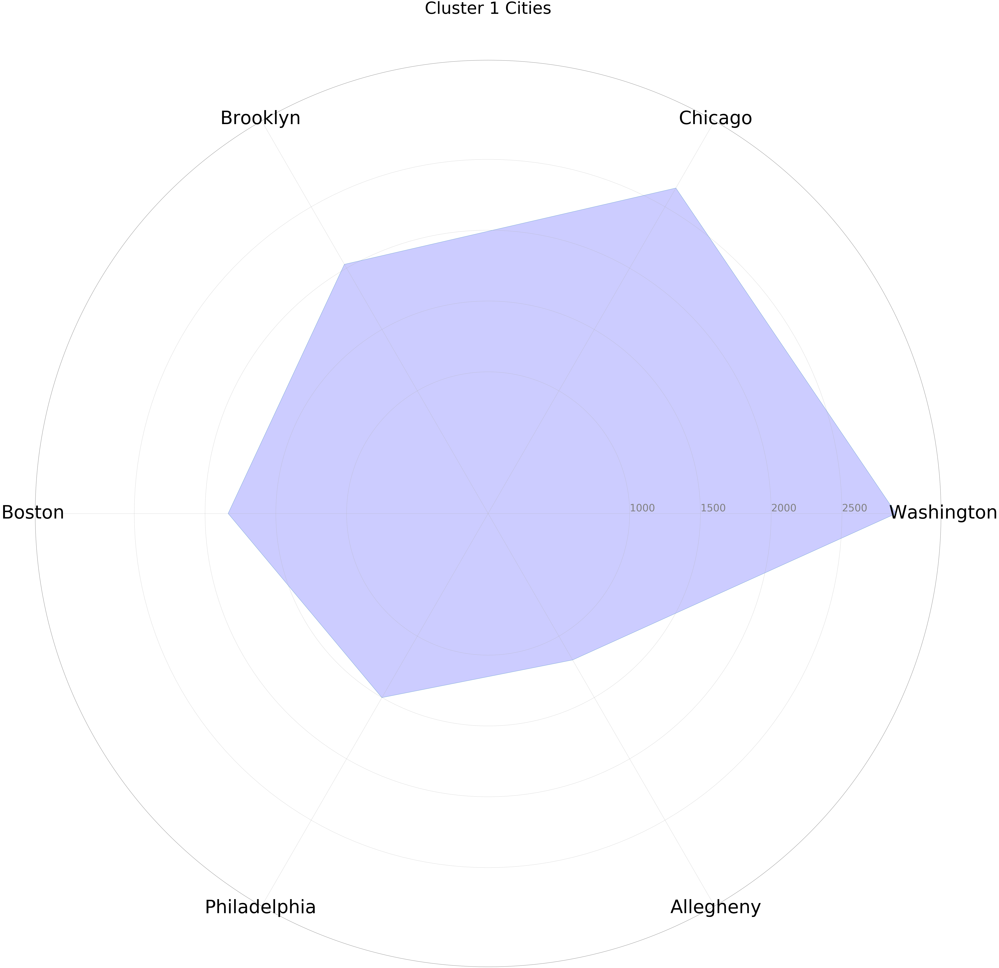

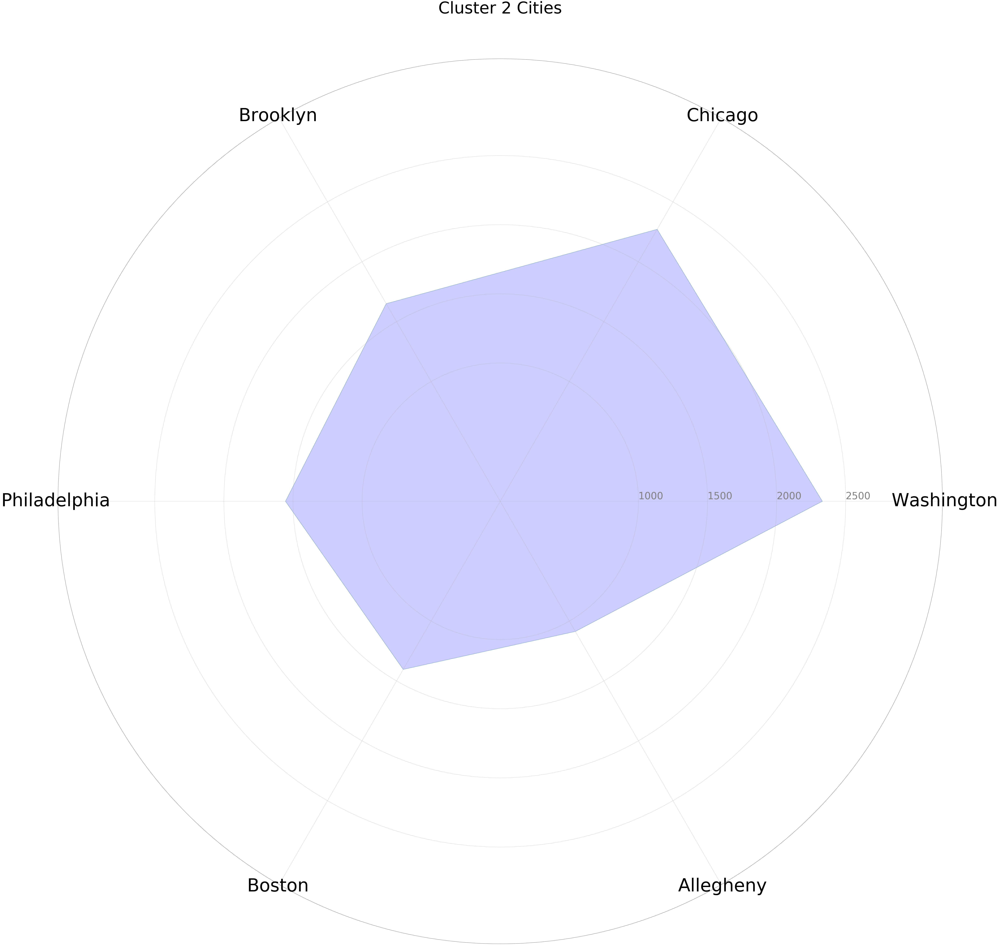

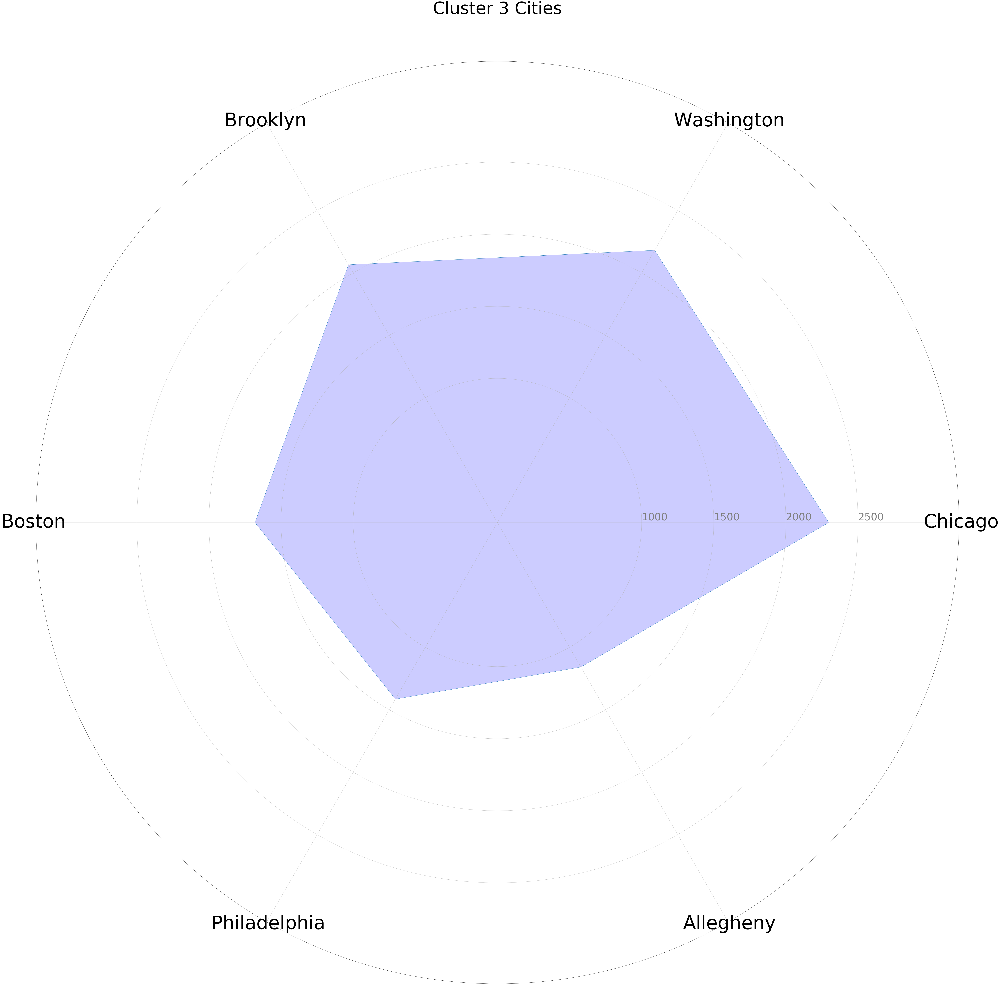

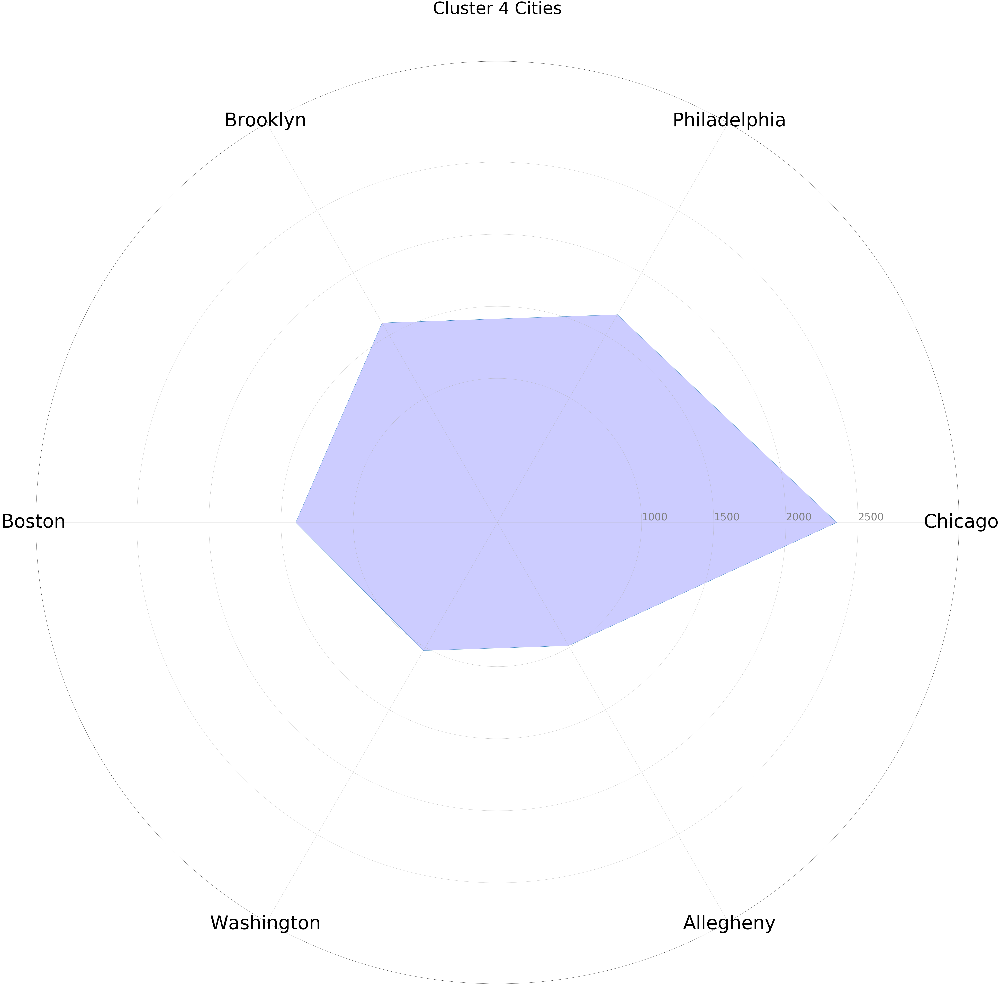

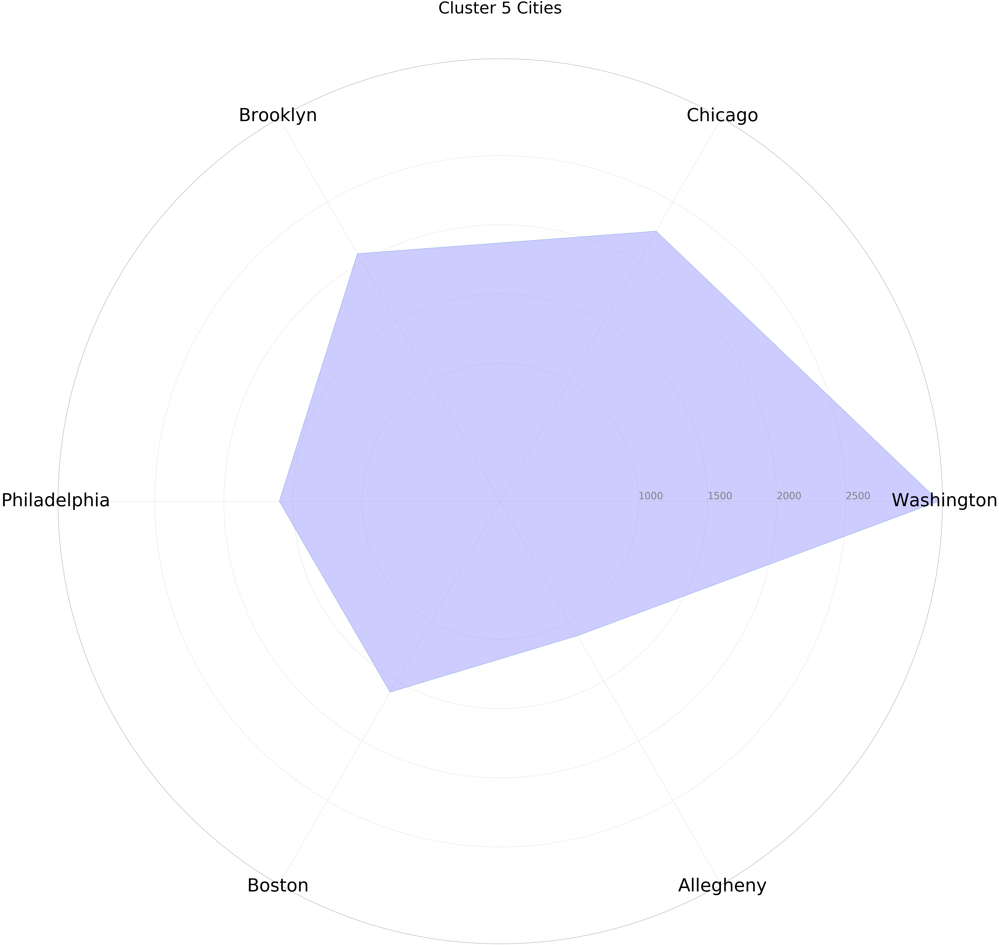

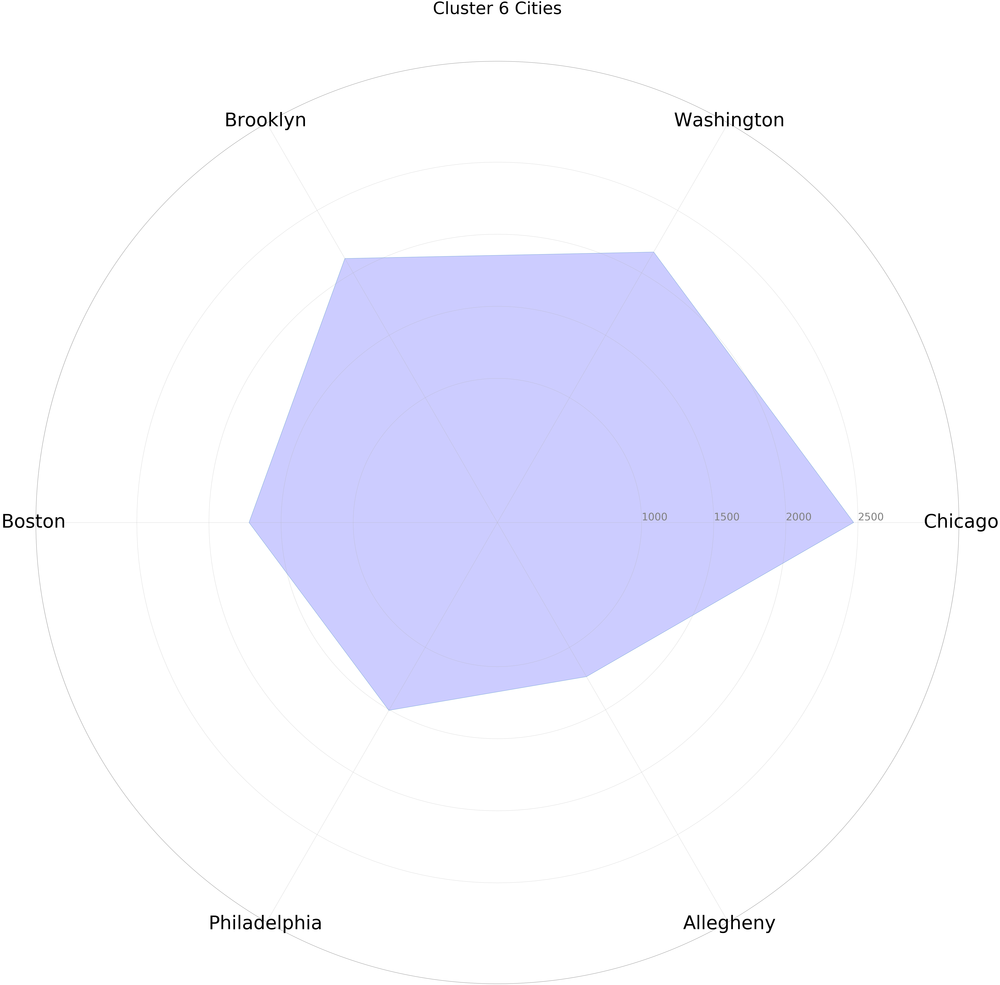

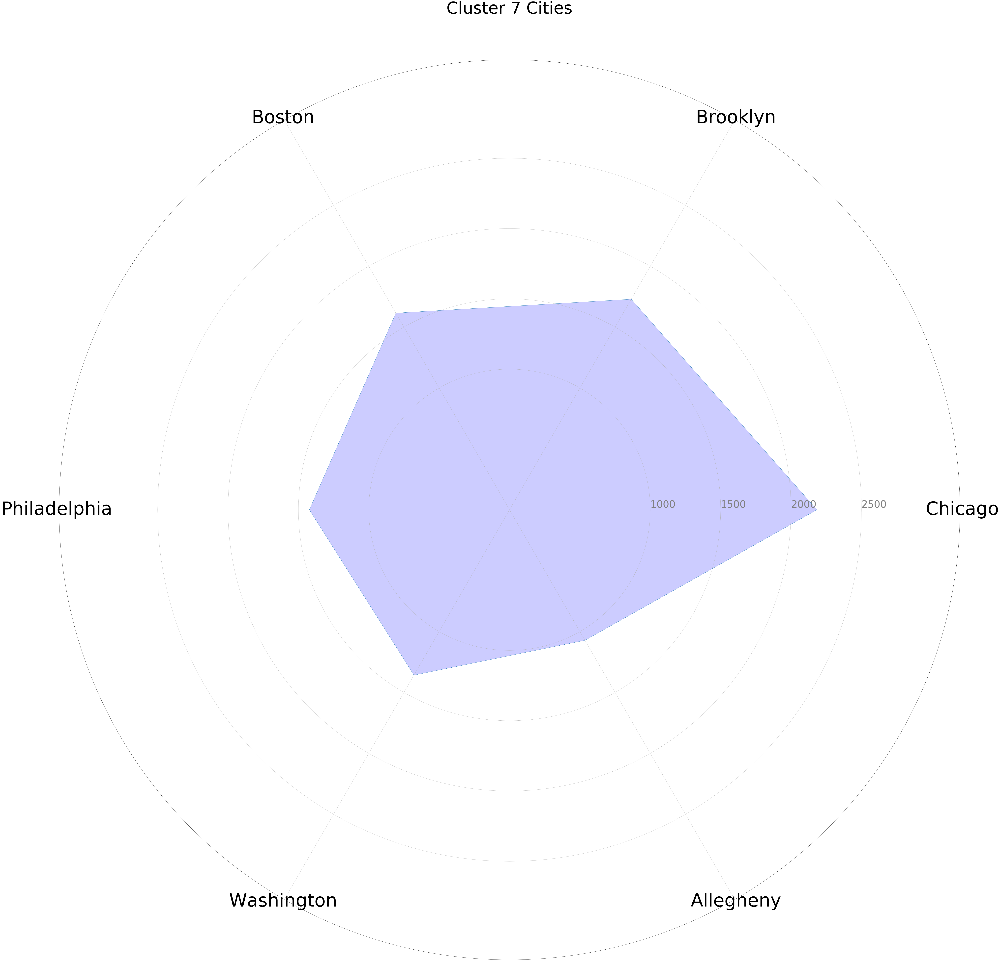

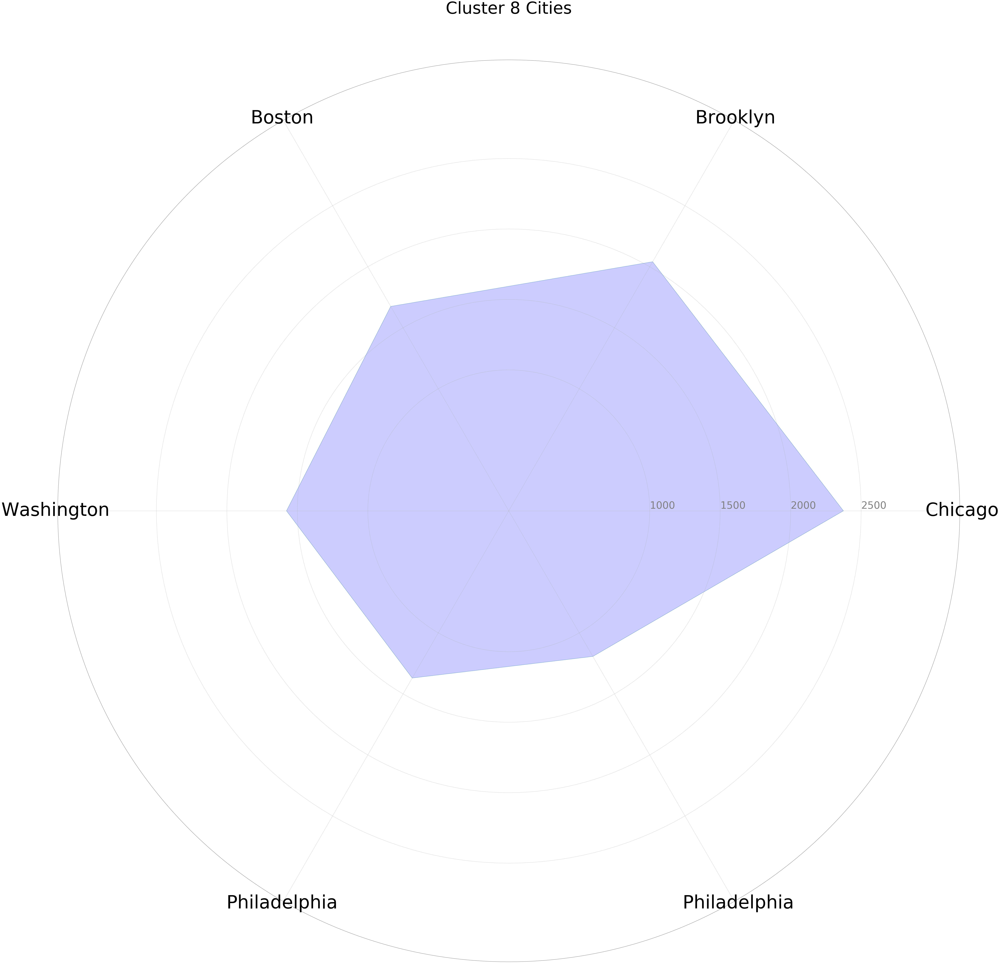

In [15]:

for j in range(8):
    list1 = list(dataByCluster)[j]
    list1C = list1[1][7]

    countedCities = list1C.value_counts()
    namesX = countedCities.index

    names = [''] * len(namesX)
    for i in range(len(namesX)):
        if(namesX[i][:9]==' New York' or namesX[i][:8]=='New York'):
            city = namesX[i]
        elif(namesX[i][-5:] == ' city'):
            city = namesX[i][:-5]
        names[i] = city

    graphName = 'Cluster ' + str(j+1) + ' Cities' 
    
    categories= names[:6]
    N = len(categories)

    # We are going to plot the first line of the data frame.
    # But we need to repeat the first value to close the circular graph:
    values= countedCities[:6]
    values = np.append(values,countedCities[0])
    print(values)

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
    plt.figure(figsize=[100,100])
    # Initialise the spider plot
    ax = plt.subplot(111, polar=True)

    # Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], categories, color='black', size=110)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([1000,1500,2000, 2500], ["1000","1500","2000", "2500"], color="grey", size=60)
    plt.ylim(0,3200)

    # Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid')
    plt.title(graphName,fontsize=100)

    # Fill area
    ax.fill(angles, values, 'b', alpha=0.2)

[2374 2041 1675 1577 1370 1193 2374]
6


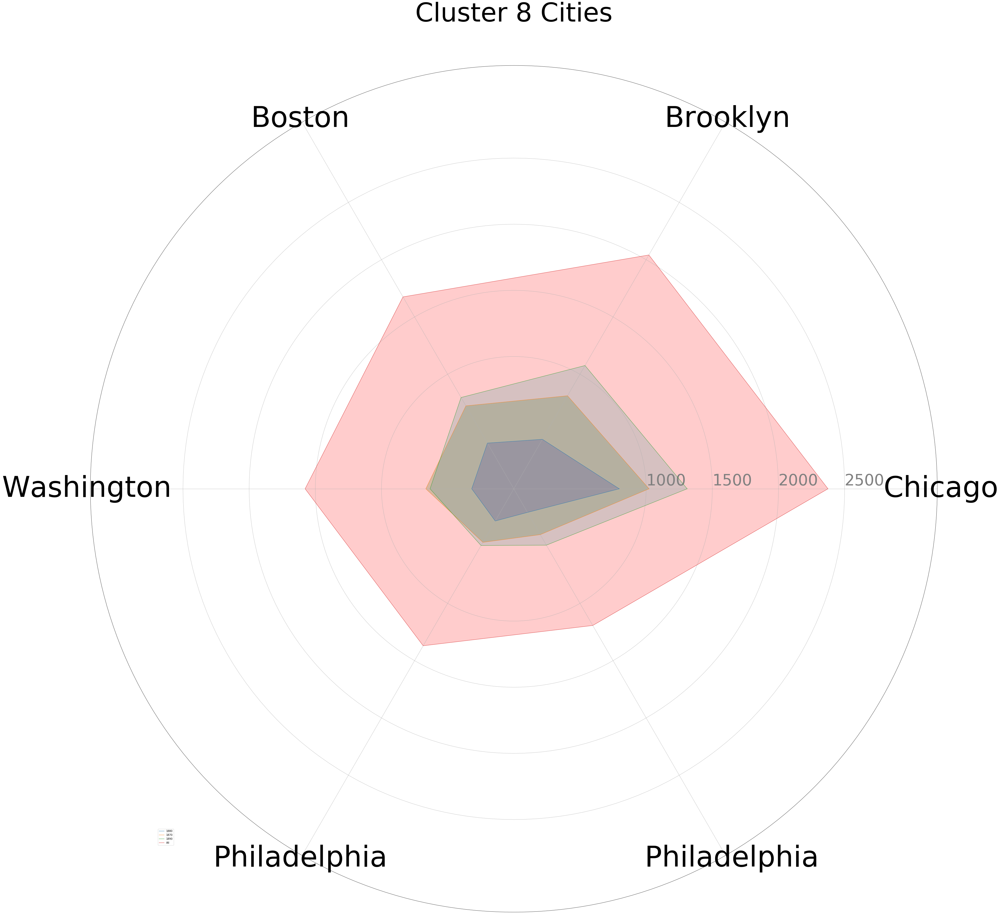

In [88]:
j=7
list1 = list(dataByCluster)[j]
list1C = list1[1][7]

countedCities = list1C.value_counts()
namesX = countedCities.index

names = [''] * len(namesX)
for i in range(len(namesX)):
    if(namesX[i][:9]==' New York' or namesX[i][:8]=='New York'):
        city = namesX[i]
    elif(namesX[i][-5:] == ' city'):
        city = namesX[i][:-5]
    names[i] = city

graphName = 'Cluster ' + str(j+1) + ' Cities' 
    
categories= names[:6]
N = len(categories)

    # We are going to plot the first line of the data frame.
    # But we need to repeat the first value to close the circular graph:
values= countedCities[:6]
values = np.append(values,countedCities[0])
print(values)

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1]
plt.figure(figsize=[60,60])
    # Initialise the spider plot
ax = plt.subplot(111, polar=True)

    # Draw one axe per variable + add labels labels yet
plt.xticks(angles[:-1], categories, color='black', size=110)

    # Draw ylabels
ax.set_rlabel_position(0)
plt.yticks([1000,1500,2000, 2500], ["1000","1500","2000", "2500"], color="grey", size=60)
plt.ylim(0,3200)

if (list(eigByCluster)[j]):
    list8 = list(eigByCluster)[j]
    list8C = list8[1][7]
    
    countedCities8 = list8C.value_counts()
    namesX8 = countedCities8.index
    values8= countedCities8[:6]
    values8 = np.append(values8,countedCities8[0])
    print(N)

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles8 = [n / float(N) * 2 * pi for n in range(N)]
    angles8 += angles8[:1]
    
if (list(sevByCluster)[j]):
    list7 = list(sevByCluster)[j]
    list7C = list7[1][7]
    
    countedCities7 = list7C.value_counts()
    namesX7 = countedCities7.index
    values7= countedCities7[:6]
    values7 = np.append(values7,countedCities7[0])

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles7 = [n / float(N) * 2 * pi for n in range(N)]
    angles7 += angles7[:1]
    
if (list(ninByCluster)[j]):
    list9 = list(ninByCluster)[j]
    list9C = list9[1][7]
    
    countedCities9 = list9C.value_counts()
    namesX9 = countedCities9.index
    values9= countedCities9[:6]
    values9 = np.append(values9,countedCities9[0])

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles9 = [n / float(N) * 2 * pi for n in range(N)]
    angles9 += angles7[:1]
    
    
ax.plot(angles8, values8, linewidth=1, linestyle='solid', label="1880")
ax.fill(angles8, values8, 'b', alpha=0.2)

ax.plot(angles7, values7, linewidth=1, linestyle='solid', label="1870")
ax.fill(angles7, values7, 'g', alpha=0.2)

ax.plot(angles9, values9, linewidth=1, linestyle='solid', label="1890")
ax.fill(angles9, values9, 'c', alpha=0.2)
    
    # Plot data
ax.plot(angles, values, linewidth=1, linestyle='solid', label="All")
plt.title(graphName,fontsize=100)

    # Fill area
ax.fill(angles, values, 'r', alpha=0.2)
plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))

[2331 2271 1650 1554 1404 1087 2331]
6
[2298 2181 2065 1681 1415 1158 2298]
6


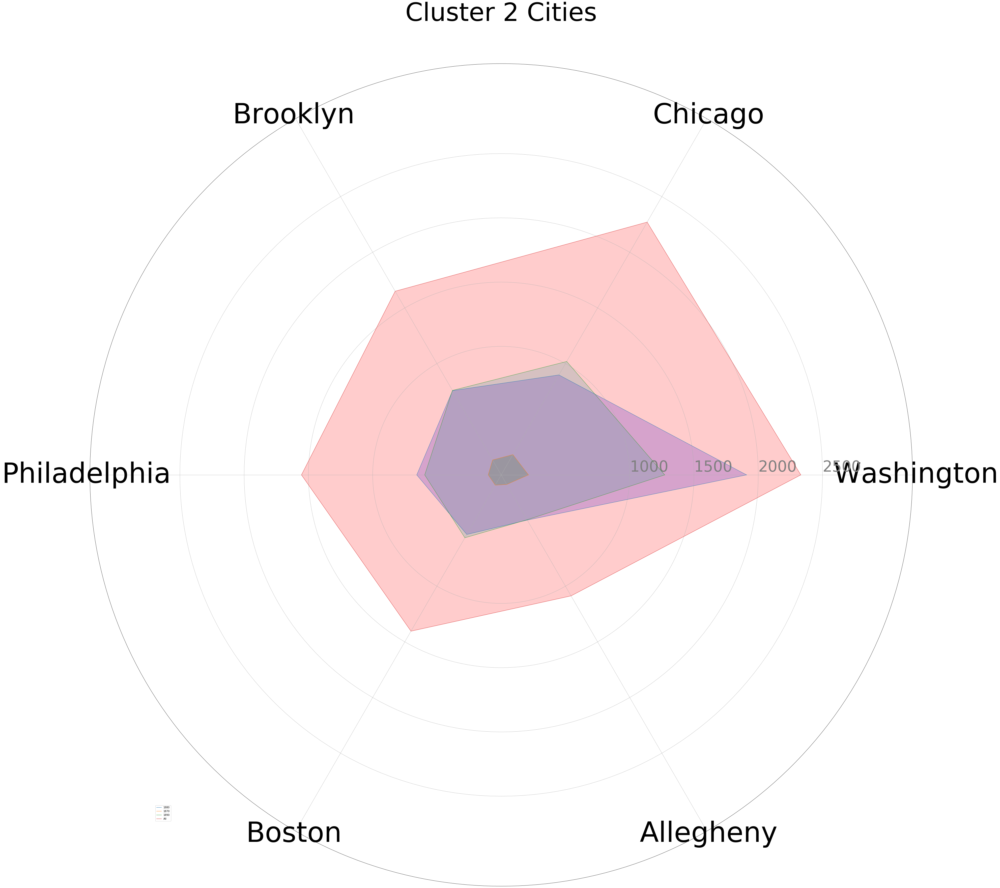

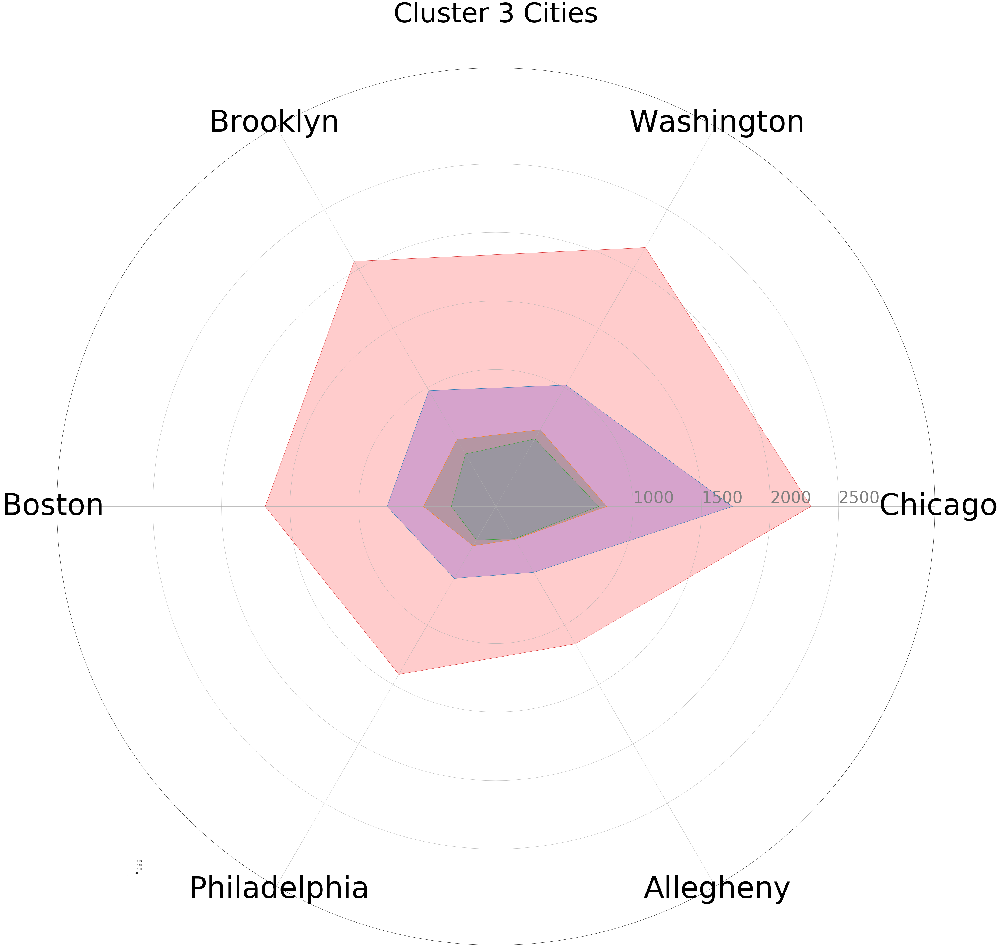

In [18]:
for j in range(1,3):
    list1 = list(dataByCluster)[j]
    list1C = list1[1][7]

    countedCities = list1C.value_counts()
    namesX = countedCities.index

    names = [''] * len(namesX)
    for i in range(len(namesX)):
        if(namesX[i][:9]==' New York' or namesX[i][:8]=='New York'):
            city = namesX[i]
        elif(namesX[i][-5:] == ' city'):
            city = namesX[i][:-5]
        names[i] = city

    graphName = 'Cluster ' + str(j+1) + ' Cities' 

    categories= names[:6]
    N = len(categories)

        # We are going to plot the first line of the data frame.
        # But we need to repeat the first value to close the circular graph:
    values= countedCities[:6]
    values = np.append(values,countedCities[0])
    print(values)

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
    plt.figure(figsize=[60,60])
        # Initialise the spider plot
    ax = plt.subplot(111, polar=True)

        # Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], categories, color='black', size=110)

        # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([1000,1500,2000, 2500], ["1000","1500","2000", "2500"], color="grey", size=60)
    plt.ylim(0,3200)

    if (list(eigByCluster)[j]):
        list8 = list(eigByCluster)[j]
        list8C = list8[1][7]

        countedCities8 = list8C.value_counts()
        namesX8 = countedCities8.index
        values8= countedCities8[:6]
        values8 = np.append(values8,countedCities8[0])
        print(N)

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
        angles8 = [n / float(N) * 2 * pi for n in range(N)]
        angles8 += angles8[:1]

    if (list(sevByCluster)[j]):
        list7 = list(sevByCluster)[j]
        list7C = list7[1][7]

        countedCities7 = list7C.value_counts()
        namesX7 = countedCities7.index
        values7= countedCities7[:6]
        values7 = np.append(values7,countedCities7[0])

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
        angles7 = [n / float(N) * 2 * pi for n in range(N)]
        angles7 += angles7[:1]

    if (list(ninByCluster)[j]):
        list9 = list(ninByCluster)[j]
        list9C = list9[1][7]

        countedCities9 = list9C.value_counts()
        namesX9 = countedCities9.index
        values9= countedCities9[:6]
        values9 = np.append(values9,countedCities9[0])

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
        angles9 = [n / float(N) * 2 * pi for n in range(N)]
        angles9 += angles7[:1]


    ax.plot(angles8, values8, linewidth=1, linestyle='solid', label="1880")
    ax.fill(angles8, values8, 'b', alpha=0.2)

    ax.plot(angles7, values7, linewidth=1, linestyle='solid', label="1870")
    ax.fill(angles7, values7, 'g', alpha=0.2)

    ax.plot(angles9, values9, linewidth=1, linestyle='solid', label="1890")
    ax.fill(angles9, values9, 'c', alpha=0.2)

        # Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid', label="All")
    plt.title(graphName,fontsize=100)

        # Fill area
    ax.fill(angles, values, 'r', alpha=0.2)
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))

[3175 2256 2068 1599 1594 1122 3175]
6
[2470 2167 2115 1722 1505 1235 2470]
6
[2184 1729 1615 1422 1358 1072 2184]
6


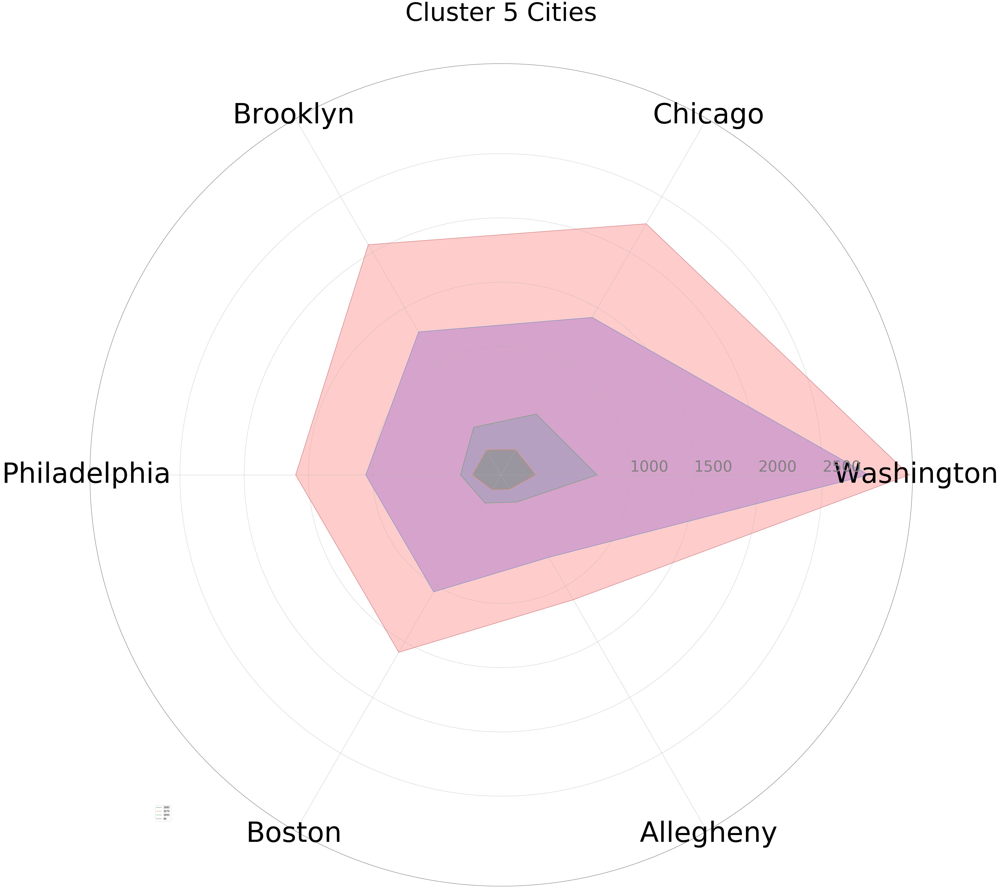

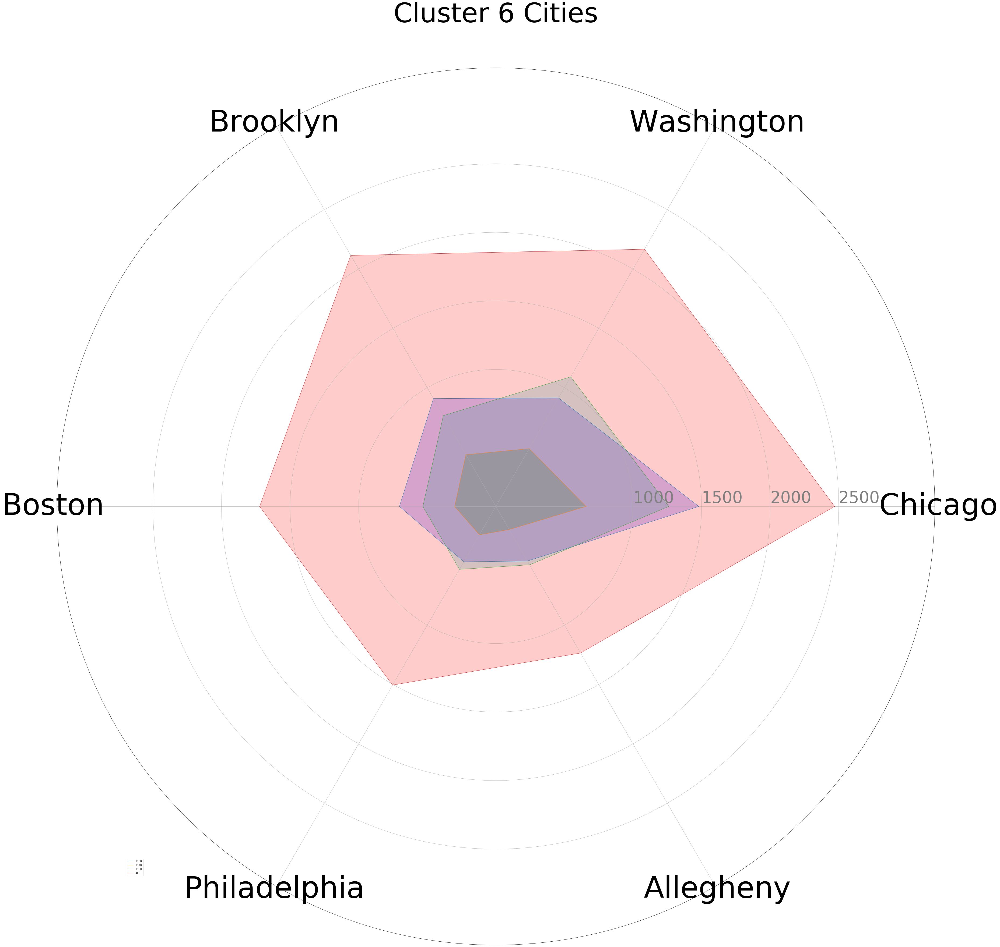

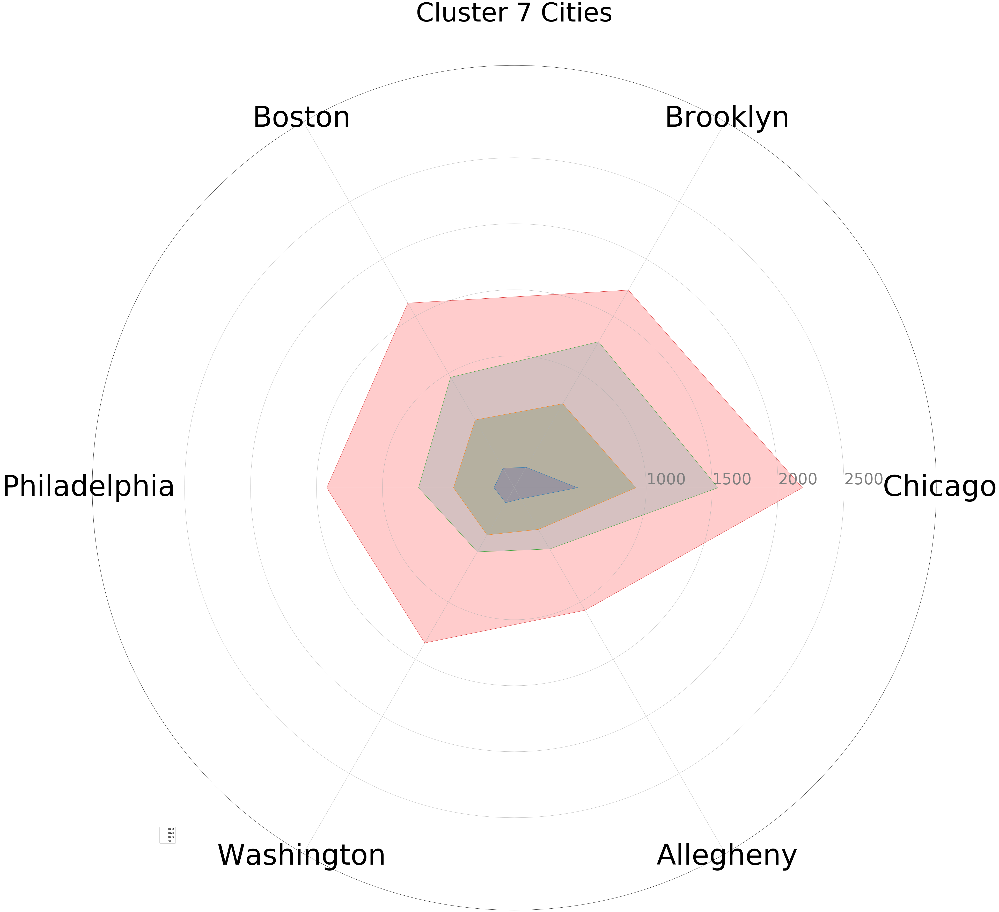

In [20]:
for j in range(4,7):
    list1 = list(dataByCluster)[j]
    list1C = list1[1][7]

    countedCities = list1C.value_counts()
    namesX = countedCities.index

    names = [''] * len(namesX)
    for i in range(len(namesX)):
        if(namesX[i][:9]==' New York' or namesX[i][:8]=='New York'):
            city = namesX[i]
        elif(namesX[i][-5:] == ' city'):
            city = namesX[i][:-5]
        names[i] = city

    graphName = 'Cluster ' + str(j+1) + ' Cities' 

    categories= names[:6]
    N = len(categories)

        # We are going to plot the first line of the data frame.
        # But we need to repeat the first value to close the circular graph:
    values= countedCities[:6]
    values = np.append(values,countedCities[0])
    print(values)

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
    plt.figure(figsize=[60,60])
        # Initialise the spider plot
    ax = plt.subplot(111, polar=True)

        # Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], categories, color='black', size=110)

        # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([1000,1500,2000, 2500], ["1000","1500","2000", "2500"], color="grey", size=60)
    plt.ylim(0,3200)

    if (list(eigByCluster)[j]):
        list8 = list(eigByCluster)[j]
        list8C = list8[1][7]

        countedCities8 = list8C.value_counts()
        namesX8 = countedCities8.index
        values8= countedCities8[:6]
        values8 = np.append(values8,countedCities8[0])
        print(N)

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
        angles8 = [n / float(N) * 2 * pi for n in range(N)]
        angles8 += angles8[:1]

    if (list(sevByCluster)[j]):
        list7 = list(sevByCluster)[j]
        list7C = list7[1][7]

        countedCities7 = list7C.value_counts()
        namesX7 = countedCities7.index
        values7= countedCities7[:6]
        values7 = np.append(values7,countedCities7[0])

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
        angles7 = [n / float(N) * 2 * pi for n in range(N)]
        angles7 += angles7[:1]

    if (list(ninByCluster)[j]):
        list9 = list(ninByCluster)[j]
        list9C = list9[1][7]

        countedCities9 = list9C.value_counts()
        namesX9 = countedCities9.index
        values9= countedCities9[:6]
        values9 = np.append(values9,countedCities9[0])

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
        angles9 = [n / float(N) * 2 * pi for n in range(N)]
        angles9 += angles7[:1]


    ax.plot(angles8, values8, linewidth=1, linestyle='solid', label="1880")
    ax.fill(angles8, values8, 'b', alpha=0.2)

    ax.plot(angles7, values7, linewidth=1, linestyle='solid', label="1870")
    ax.fill(angles7, values7, 'g', alpha=0.2)

    ax.plot(angles9, values9, linewidth=1, linestyle='solid', label="1890")
    ax.fill(angles9, values9, 'c', alpha=0.2)

        # Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid', label="All")
    plt.title(graphName,fontsize=100)

        # Fill area
    ax.fill(angles, values, 'r', alpha=0.2)
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))

[2374 2041 1675 1577 1370 1193 2374]
6


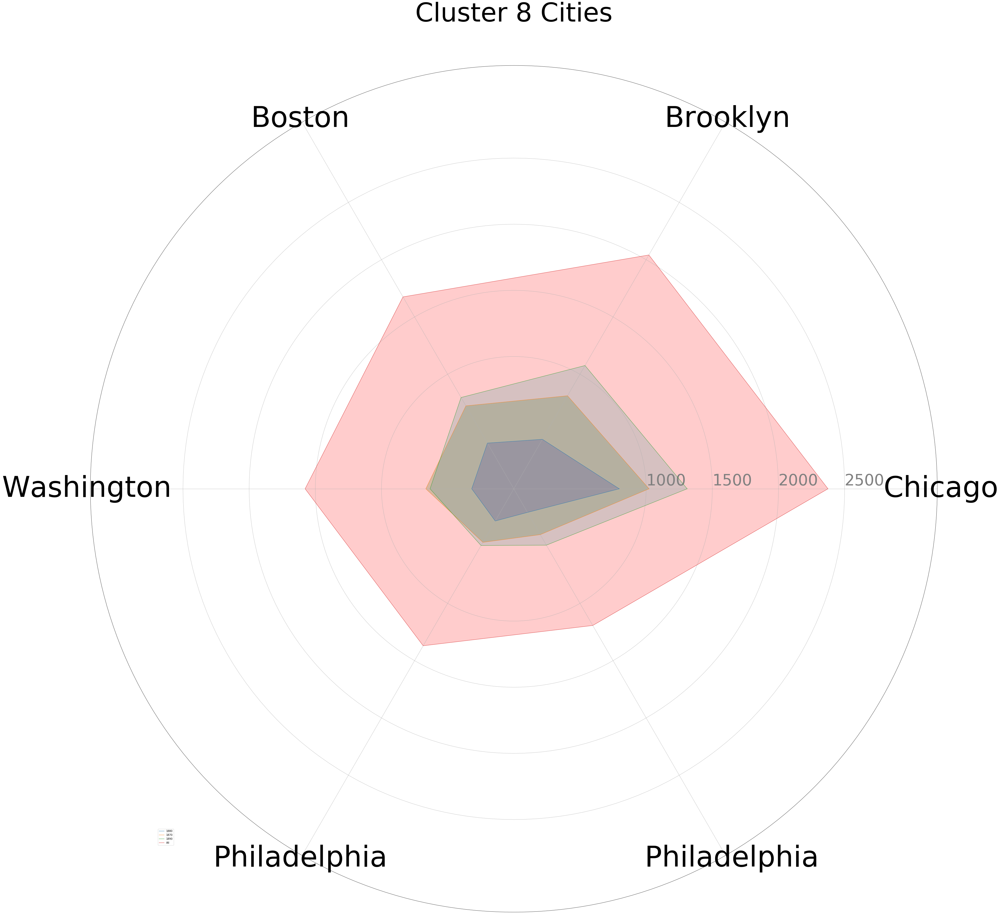

In [21]:
for j in range(7,8):
    list1 = list(dataByCluster)[j]
    list1C = list1[1][7]

    countedCities = list1C.value_counts()
    namesX = countedCities.index

    names = [''] * len(namesX)
    for i in range(len(namesX)):
        if(namesX[i][:9]==' New York' or namesX[i][:8]=='New York'):
            city = namesX[i]
        elif(namesX[i][-5:] == ' city'):
            city = namesX[i][:-5]
        names[i] = city

    graphName = 'Cluster ' + str(j+1) + ' Cities' 

    categories= names[:6]
    N = len(categories)

        # We are going to plot the first line of the data frame.
        # But we need to repeat the first value to close the circular graph:
    values= countedCities[:6]
    values = np.append(values,countedCities[0])
    print(values)

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
    plt.figure(figsize=[60,60])
        # Initialise the spider plot
    ax = plt.subplot(111, polar=True)

        # Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], categories, color='black', size=110)

        # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([1000,1500,2000, 2500], ["1000","1500","2000", "2500"], color="grey", size=60)
    plt.ylim(0,3200)

    if (list(eigByCluster)[j]):
        list8 = list(eigByCluster)[j]
        list8C = list8[1][7]

        countedCities8 = list8C.value_counts()
        namesX8 = countedCities8.index
        values8= countedCities8[:6]
        values8 = np.append(values8,countedCities8[0])
        print(N)

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
        angles8 = [n / float(N) * 2 * pi for n in range(N)]
        angles8 += angles8[:1]

    if (list(sevByCluster)[j]):
        list7 = list(sevByCluster)[j]
        list7C = list7[1][7]

        countedCities7 = list7C.value_counts()
        namesX7 = countedCities7.index
        values7= countedCities7[:6]
        values7 = np.append(values7,countedCities7[0])

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
        angles7 = [n / float(N) * 2 * pi for n in range(N)]
        angles7 += angles7[:1]

    if (list(ninByCluster)[j]):
        list9 = list(ninByCluster)[j]
        list9C = list9[1][7]

        countedCities9 = list9C.value_counts()
        namesX9 = countedCities9.index
        values9= countedCities9[:6]
        values9 = np.append(values9,countedCities9[0])

        # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
        angles9 = [n / float(N) * 2 * pi for n in range(N)]
        angles9 += angles7[:1]


    ax.plot(angles8, values8, linewidth=1, linestyle='solid', label="1880")
    ax.fill(angles8, values8, 'b', alpha=0.2)

    ax.plot(angles7, values7, linewidth=1, linestyle='solid', label="1870")
    ax.fill(angles7, values7, 'g', alpha=0.2)

    ax.plot(angles9, values9, linewidth=1, linestyle='solid', label="1890")
    ax.fill(angles9, values9, 'c', alpha=0.2)

        # Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid', label="All")
    plt.title(graphName,fontsize=100)

        # Fill area
    ax.fill(angles, values, 'r', alpha=0.2)
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))